In [44]:
import pandas as pd
import numpy as np

from skopt.space import Real, Integer
from keras.models import Model
from keras.layers import Input, Dense, Dropout
from keras.optimizers import Adam

from sklearn.preprocessing import StandardScaler
from skopt.space import Real, Integer

from scipy.stats import qmc  
from GPyOpt.methods import BayesianOptimization

from sklearn.metrics import mean_squared_error, r2_score

Neural Network Model for Hyper Parameter Tuning

In [45]:
def benchmark(X, Y):
    return -((X**2 + Y - 11)**2 + (X + Y**2 - 7)**2)


In [46]:
# Random seed
np.random.seed(1)

# Number of observations to train the GP on before starting the active learning loop
pretrain_n = 10

# Standard deviation of simulated response
sim_stdev = 0.02

# Number of bayesian optimization iterations for calibrating simulation model
max_bo_iter = 150

# Random seed
r = np.random.default_rng(seed=2)

In [47]:
ran_err = lambda n, x: r.normal(0, x, n)
sim_err = lambda x, y, a, b: 0.1 * (a - 4) * x + 0.05 * (b + 3) * y**2 + 0.03 * x * y + r.normal(0, sim_stdev)

In [48]:
def initialize_df(n):
    # Generate 10 random data points for 2 inputs (X, Y) within specified bounds
    X = np.random.uniform(-5, 5, n)
    Y = np.random.uniform(-5, 5, n)

    # Calculate the outputs using Himmelblau's Function
    output1 = benchmark(X, Y) + ran_err(n, 0.05)

    # Generate Initial Dataset of Physical Experiments
    df = pd.DataFrame({
        'x': X,
        'y': Y,
        'z': output1,
    })
    return df


In [49]:
sim_eval = lambda x, y, a, b: benchmark(x, y) + sim_err(x, y, a, b)

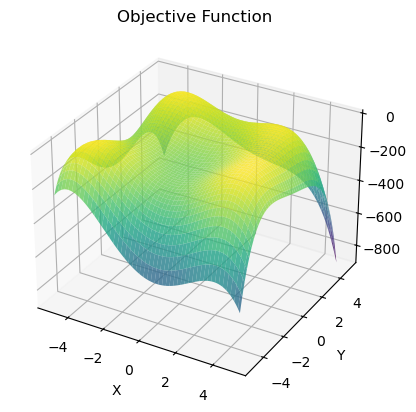

In [50]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Create the grid of input values
x_range = np.linspace(-5, 5, 100)
y_range = np.linspace(-5, 5, 100)
x_grid, y_grid = np.meshgrid(x_range, y_range)

# Evaluate function on grid
z_grid = benchmark(x_grid, y_grid)

# Create the plot
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(x_grid, y_grid, z_grid, cmap='viridis', alpha=0.8)

# Customize the plot
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_title('Objective Function')

# Show the plot
plt.show()

In [51]:
# Define the hyperparameter space
hyp_space  = [
    Integer(2, 10, name='num_layers'), # Num of layers in the network (depth)
    Integer(50, 200, name='num_units'), # Num of neurons in each hidden layer (width)
    Real(0.00001, 0.1, prior='log-uniform', name='learning_rate'), # Steps size at each iteration 
    Real(0.0, 0.5, name='dropout_rate'), # Probability of droping out a neuron
    Integer(20, 150, name='batch_size'), # Num of samples per batch
    Integer(50, 200, name='epochs') # Num of epochs (iterations over the entire dataset) during training
]

# Defining the Neural Network Model
def NN_model(num_layers, num_units, learning_rate, dropout_rate):
    inputs = Input(shape=(2,))
    x = Dense(num_units, activation='relu', kernel_regularizer='l2')(inputs)
    for _ in range(num_layers - 1):
        x = Dense(num_units, activation='relu', kernel_regularizer='l2')(x)
        x = Dropout(dropout_rate)(x)
    outputs = Dense(1, activation='linear')(x)
    model = Model(inputs=inputs, outputs=outputs)
    model.compile(optimizer=Adam(learning_rate=learning_rate), loss='mean_squared_error')
    return model

# Function for MC Dropout predictions
def mc_dropout_predictions(model, X, num_samples=50):
    predictions = np.zeros((num_samples, X.shape[0]))
    for i in range(num_samples):
        predictions[i, :] = model(X, training=True).numpy().flatten()
    prediction_mean = predictions.mean(axis=0)
    prediction_std = predictions.std(axis=0)
    return prediction_mean, prediction_std


In [52]:
# Define the known global maxima for the Himmelblau's function
global_maxima_points = [
    {"X": 3, "Y":  2, "Z": benchmark(0,  0)},
    {"X": -2.805, "Y":  3.131, "Z": benchmark(0,  0)},
    {"X": -3.779, "Y":  -3.283, "Z": benchmark(0,  0)},
    {"X": 3.584, "Y":  -1.848, "Z": benchmark(0,  0)},
]

# Create a DataFrame for the global maxima
global_maxima_df = pd.DataFrame(global_maxima_points)
global_maxima_df

,X,Y,Z
0,3.000,2.000,-170
1,-2.805,3.131,-170
2,-3.779,-3.283,-170
3,3.584,-1.848,-170


In [53]:
rmse_list = []
r2_list = []
iteration_list = []

In [54]:
def perform_iteration(df, iteration, rmse_list, r2_list, iteration_list, exp_n):

    def sim_all(x):
        df["a"] = x[0,0]
        df["b"] = x[0,1]
        df["sim_z"] = sim_eval(df["x"], df["y"], df["a"], df["b"])
        df["diff"] = df["z"] - df["sim_z"]
        return (df["diff"]**2).sum()

    bo_domain = [{'name': 'a', 'type': 'continuous', 'domain': (-10,10)},
            {'name': 'b', 'type': 'continuous', 'domain': (-10,10)}]

    # Calibrate the sim model using physical tests so far, update df["a"] and df["b"] with calibrated parameters
    bo = BayesianOptimization(f=sim_all, domain=bo_domain, acquisition_type='EI')
    bo.run_optimization(max_iter=max_bo_iter)
    df["a"] = bo.x_opt[0]
    df["b"] = bo.x_opt[1]
    print(bo.x_opt)

    # Create the grid of input values
    x_range = np.linspace(-5, 5, 100)
    y_range = np.linspace(-5, 5, 100)
    x_grid, y_grid = np.meshgrid(x_range, y_range)
    sim_z_grid = sim_eval(x_grid, y_grid, bo.x_opt[0], bo.x_opt[1])

    # Create the plot
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.plot_surface(x_grid, y_grid, sim_z_grid, cmap='viridis', alpha=0.8)

    # Customize the plot
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_title('True Function with Simulation Calibrated Errors')

    # Show the plot
    plt.show()

    # Generate 15 points using Latin Hypercube Sampling (LHS)
    n_samples = 90
    lhs= qmc.LatinHypercube(d=2, optimization="random-cd")
    lhs_samples = lhs.random(n=n_samples)
    bounds = np.array([[-5, 5], [-5, 5]])  # Bounds for Design Space

    scaled_samples = qmc.scale(lhs_samples, bounds[:, 0], bounds[:, 1])

    selected_points_df = pd.DataFrame(scaled_samples, columns=['x', 'y'])
    selected_points_df['sim_z'] = sim_eval(selected_points_df['x'], selected_points_df['y'], bo.x_opt[0], bo.x_opt[1])

    sim_df = df[["x", "y", "sim_z"]]
    sim_df = pd.concat([sim_df, selected_points_df], axis=0, ignore_index=True)

    # Train the model with the best hyperparameters on the entire dataset
    best_model = NN_model(
        num_layers=6,
        num_units=300,
        learning_rate=0.0007,
        dropout_rate=0.5
    )

    # Standardize the Dataset of Simulation Responses
    scaler= StandardScaler().fit(sim_df[['x', 'y']])
    X_scaled = scaler.transform(sim_df[['x', 'y']])

    # Train the best model on the combined standardized dataset
    best_model.fit(X_scaled, sim_df[['sim_z']], epochs=500, batch_size=150, verbose=1)

    # Create a meshgrid and combine into a single array
    xy_grid = np.c_[x_grid.ravel(), y_grid.ravel()]

    # Perform MC Dropout predictions on the entire grid
    xy_grid_scaled = scaler.transform(xy_grid)
    pred_mean, pred_std = mc_dropout_predictions(best_model, xy_grid_scaled)

    # Ploting mean predictions and confidence intervals
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')

    # Reshaping predictions back to grid shape
    pred_mean_grid = pred_mean.reshape(x_grid.shape)
    pred_upper_grid = (pred_mean + (1.96 * pred_std)).reshape(x_grid.shape)
    pred_lower_grid = (pred_mean - (1.96 * pred_std)).reshape(x_grid.shape)

    mean_surface = ax.plot_surface(x_grid, y_grid, pred_mean_grid, color='blue', alpha=0.5, label='Mean Prediction')
    upper_surface = ax.plot_surface(x_grid, y_grid, pred_upper_grid, color='red', alpha=0.3, label='Upper Bound (95% CI)')
    lower_surface = ax.plot_surface(x_grid, y_grid, pred_lower_grid, color='green', alpha=0.3, label='Lower Bound (95% CI)')

    # Customize the plot
    ax.set_title('Neural Network of Simulated Response with Confidence Intervals')
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Output')

    # Legend
    legend_elements = [mean_surface, upper_surface, lower_surface]
    fig.legend(handles=legend_elements, loc='upper left', bbox_to_anchor=(0.1, 0.9))

    # Show the plot
    plt.show()
    
    x_range = [(-5, 5)]
    y_range = [(-5, 5)]
    def p_nn(xy):
        xy = np.array(xy).reshape(1, -1)  # Ensure correct shape (1,2)
        xy_scaled = scaler.transform(xy)
        pred_mean, pred_std = mc_dropout_predictions(best_model, xy_scaled)
        # Check if the point is inside the valid domain
        if (x_range[0][0] <= xy[0, 0] <= x_range[0][1] and 
                y_range[0][0] <= xy[0, 1] <= y_range[0][1]):
            return max(pred_mean + 1.96 * pred_std - sim_df["sim_z"].median(), 0)
        else:
            return 1e-10


    def metropolis_step(xy, sig):
        prop_xy = xy + np.random.normal(0, sig, size=xy.shape)  # Generate a candidate

        # Ensure proposed point is inside the valid bounds
        if not (x_range[0][0] <= prop_xy[0, 0] <= x_range[0][1] and 
                y_range[0][0] <= prop_xy[0, 1] <= y_range[0][1]):
            return xy  # Reject out-of-bounds proposals

        u = np.random.uniform(0, 1)
        denom = max(p_nn(xy), 1e-8)  # small epsilon to prevent division by zero
        accept_ratio = p_nn(prop_xy) / denom
        if u < min(1.0, accept_ratio):
            return prop_xy
        else:
            return xy

    def mh_sampler(sig, sample_size, burn_in, lag):
        # Start at the point with the largest simulated response
        max_idx = np.argmax(sim_df["sim_z"])
        x_init = sim_df["x"].iloc[max_idx]
        y_init = sim_df["y"].iloc[max_idx]
        xy = np.array([[x_init, y_init]])

        # Burn-in phase
        for i in range(burn_in):
            xy = metropolis_step(xy, sig)

        # Sampling phase
        output = xy
        for i in range(sample_size - 1):
            for j in range(lag):
                xy = metropolis_step(xy, sig)
            output = np.vstack((output, xy))  # Stack valid samples

        return output  # Returns an array of shape (sample_size, 2)

    # Find point with highest NN predicted mean response
    flat_pred_mean = pred_mean.flatten()
    max_idx = np.argmax(flat_pred_mean)

    x_max = xy_grid[max_idx, 0]
    y_max = xy_grid[max_idx, 1]
    max_point = np.array([[x_max, y_max]])

    X_mh = mh_sampler(sig=5, sample_size=exp_n - 1, burn_in=50, lag=20)

    X_all = np.vstack([max_point, X_mh])

    physical_test_points = pd.DataFrame(X_all, columns=["x", "y"])

    # Generate predictions for the heatmap
    pred_mean_grid = pred_mean.reshape(x_grid.shape)

    # Plot the heatmap
    plt.figure(figsize=(10, 8))
    heatmap = plt.contourf(x_grid, y_grid, pred_mean_grid, cmap='viridis', levels=50)
    plt.colorbar(heatmap, label="Neural Network Response")

    # Overlay sampled points
    plt.scatter(sim_df['x'], sim_df['y'], color='white', edgecolor='black', label='Simulation Sampled Points')
    plt.scatter(physical_test_points['x'], physical_test_points['y'], color='purple', edgecolor='black', label='Next Physical Test Points')

    # Customize the plot
    plt.title("Heatmap of Neural Network Response")
    plt.xlabel("X1")
    plt.ylabel("X2")
    plt.legend()
    plt.show()

    # Add validated data points to original data frame
    physical_test_points["z"] = benchmark(physical_test_points['x'], physical_test_points['y']) + ran_err(exp_n, 0.05)
    physical_test_points["a"] = bo.x_opt[0]
    physical_test_points["b"] = bo.x_opt[1]
    physical_test_points["sim_z"] = sim_eval(physical_test_points["x"], physical_test_points["y"], physical_test_points["a"], physical_test_points["b"])
    physical_test_points["diff"] = physical_test_points["z"] - physical_test_points["sim_z"]

    # Heatmap of Simulated Points 
    fig, ax = plt.subplots(figsize=(10, 8))

    # Plot the heatmap for sim_z_grid
    heatmap = ax.contourf(x_grid, y_grid, sim_z_grid, levels=100, cmap='viridis', alpha=0.8)

    # Overlay scatter points for sampling points
    ax.scatter(df["x"], df["y"], color='blue', marker='o', label='Previous Sampled Points')
    ax.scatter(sim_df["x"], sim_df["y"], edgecolor='black', facecolors='none', marker='o', label='Sampled Simulation Points')
    ax.scatter(physical_test_points["x"], physical_test_points["y"], color='purple', marker='o', label='Next Physical Test Points')
    # Annotate coordinates of next physical test points
    for i, row in physical_test_points.iterrows():
        ax.text(row["x"], row["y"], f"({row['x']:.1f}, {row['y']:.1f})", 
                fontsize=8, ha='center', va='bottom', color='black', 
                bbox=dict(boxstyle='round,pad=0.2', fc='white', alpha=0.5))

    # Overlay scatter points for global maxima
    ax.scatter(global_maxima_df['X'], global_maxima_df['Y'], color='red', marker='o', label='Global Maximum Point')

    # Customize the plot
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_title('True Function with Simulation Calibrated Errors (Heatmap)')
    ax.legend()

    # Add a color bar
    cbar = plt.colorbar(heatmap, ax=ax)
    cbar.set_label('Function Value (Z)')

    # Show the plot
    plt.show()

    # Add points to original dataframe
    df = pd.concat([df, physical_test_points], axis=0, ignore_index=True)

    # Track Physical Test Points
    print(f"Selected {len(physical_test_points)} new test points. Median diff: {physical_test_points['diff'].median():.4f}")

    # Compute RMSE and R² between true and simulated values
    rmse = mean_squared_error(df["z"], df["sim_z"], squared=False)
    r2 = r2_score(df["z"], df["sim_z"])

    # Log metrics
    rmse_list.append(rmse)
    r2_list.append(r2)
    iteration_list.append(iteration)

    print(f"[Iteration {iteration}] RMSE: {rmse:.4f}, R²: {r2:.4f}")

    return df

In [55]:
experiment_counts = [5, 10, 15, 20, 25]  # Number of physical experiments to test
n_iterations_per_run = 7  # How many iterations to run per pipeline execution

In [56]:
results = []

def log_metrics(exp_count, iteration, rmse, r2, best_z):
    results.append({
        "Physical_Experiment_Count": exp_count,
        "Iteration": iteration,
        "RMSE": rmse,
        "R2": r2,
        "Best_Z": best_z
    })


=== Running with 5 physical experiments ===
[ 4.32432971 -3.06924425]


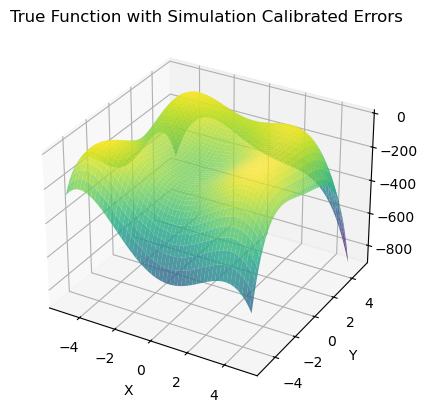

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 31235.6914
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 31198.6992
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 31140.1465
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 31065.8457
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 30972.4297
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 30852.6211
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 30641.2520
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 30463.0430
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 30190.4902
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 29736.5820
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 29229.7559
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 28268.9023
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 27213.4258
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 25954.9824
Epoch 15/500
1/1 ━━━━━━━━━━━━━━

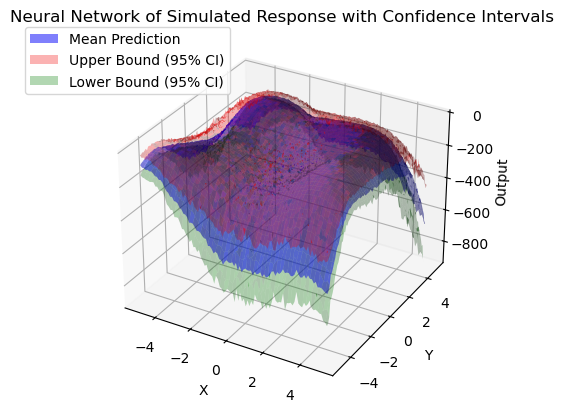

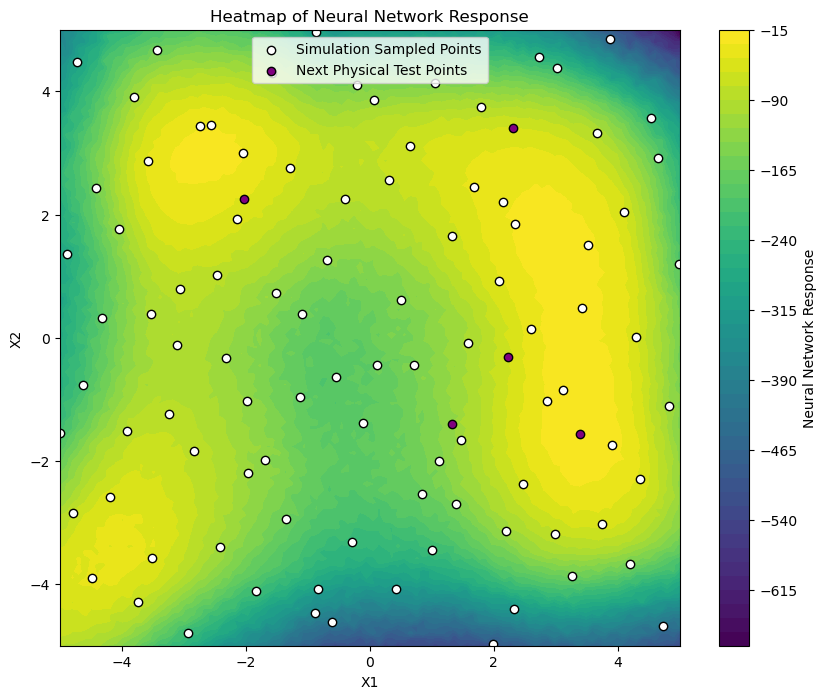

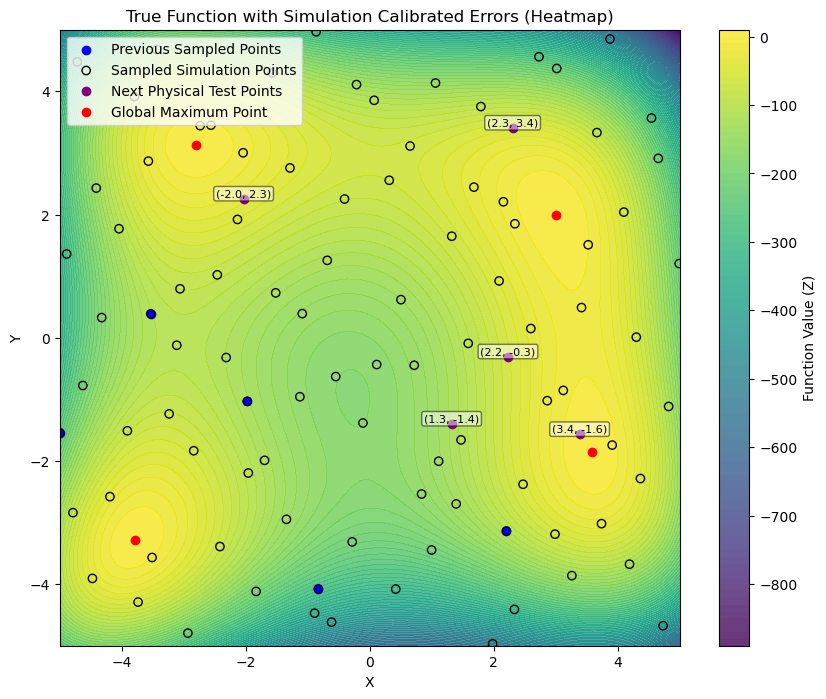

Selected 5 new test points. Median diff: 0.0289
[Iteration 0] RMSE: 2.2547, R²: 0.9993
[ 4.23880627 -3.17748079]


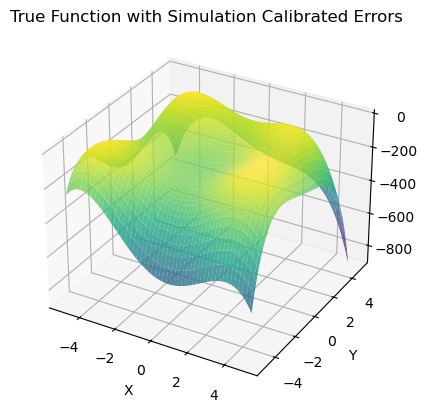

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 29863.3184
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 29826.5547
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 29740.6934
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 29663.7422
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 29546.9395
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 29396.1758
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 29139.4199
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 28762.2148
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 28313.4102
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 27731.9453
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 26770.2070
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 25667.4082
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 24167.1016
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 22476.0000
Epoch 15/500
1/1 ━━━━━━━━━━━━━━

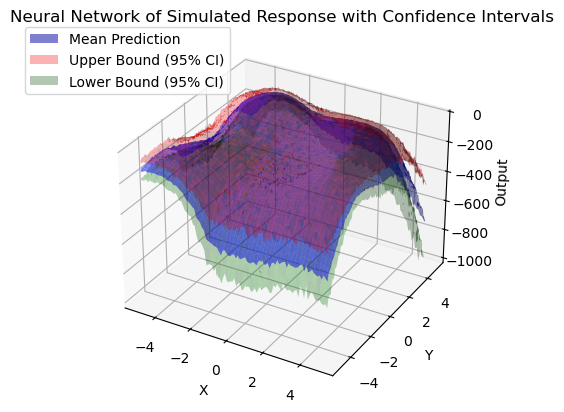

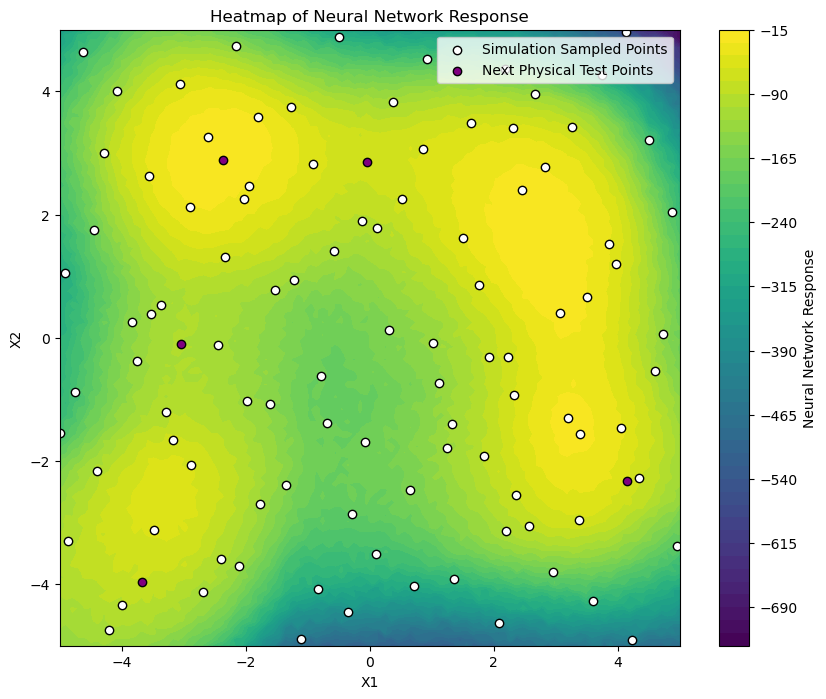

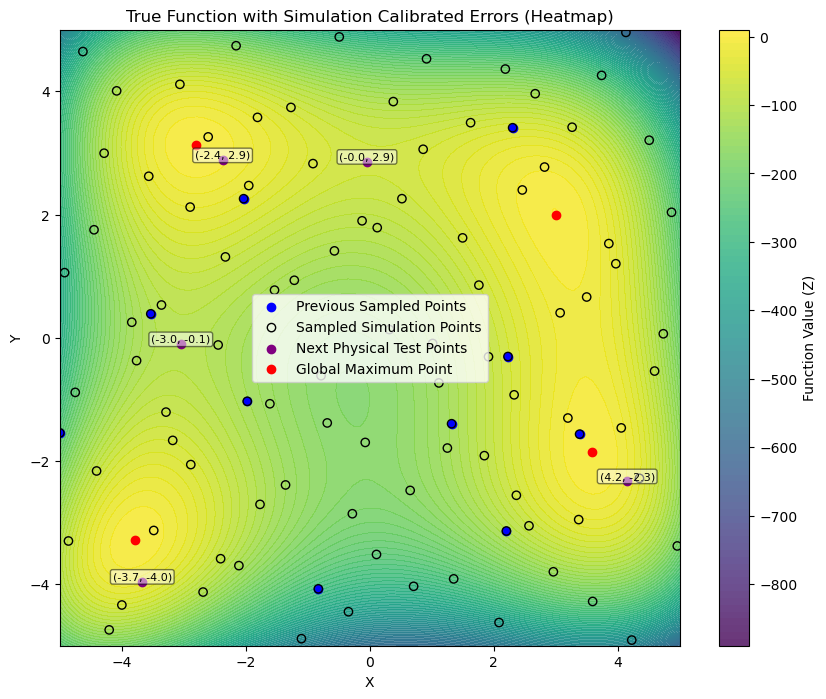

Selected 5 new test points. Median diff: 0.1459
[Iteration 1] RMSE: 0.2468, R²: 1.0000
[ 4.29371963 -3.15374289]


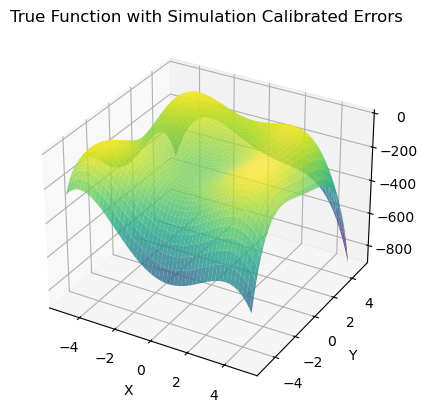

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 28442.2188
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 28393.6426
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 28344.2734
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 28272.0332
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 28188.5195
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 28057.5586
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 27864.5508
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 27498.0801
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 27173.1270
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 26678.2109
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 25945.7539
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 25069.7832
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 23699.7090
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 22581.0215
Epoch 15/500
1/1 ━━━━━━━━━━━━━━

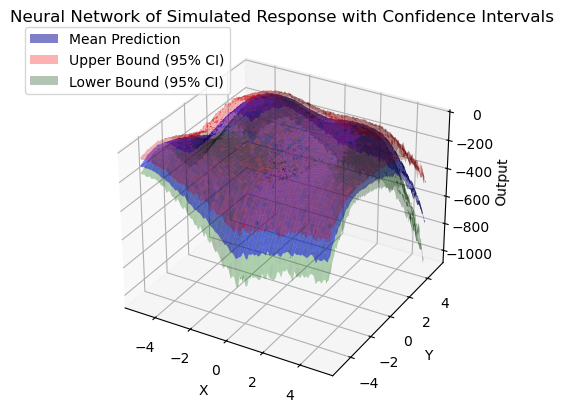

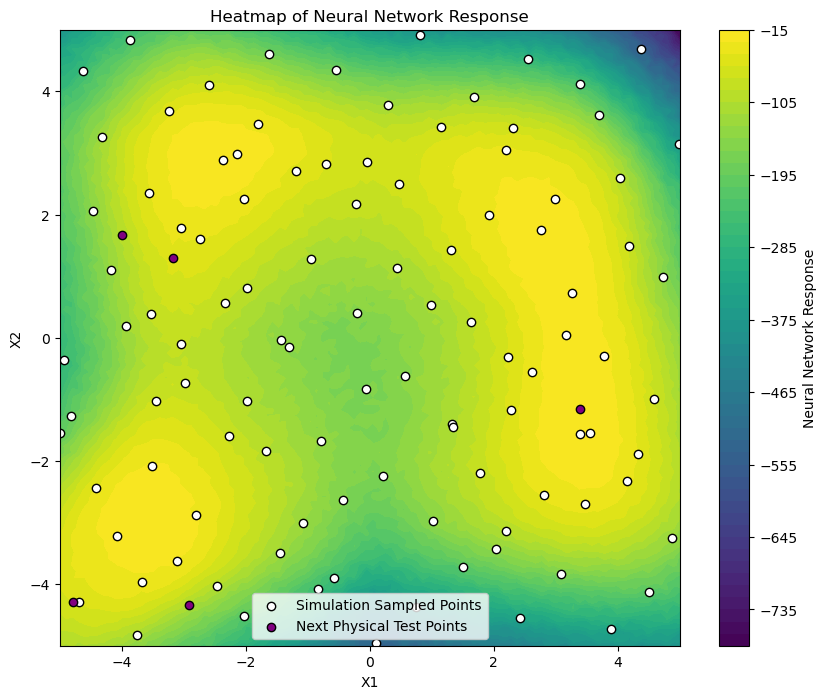

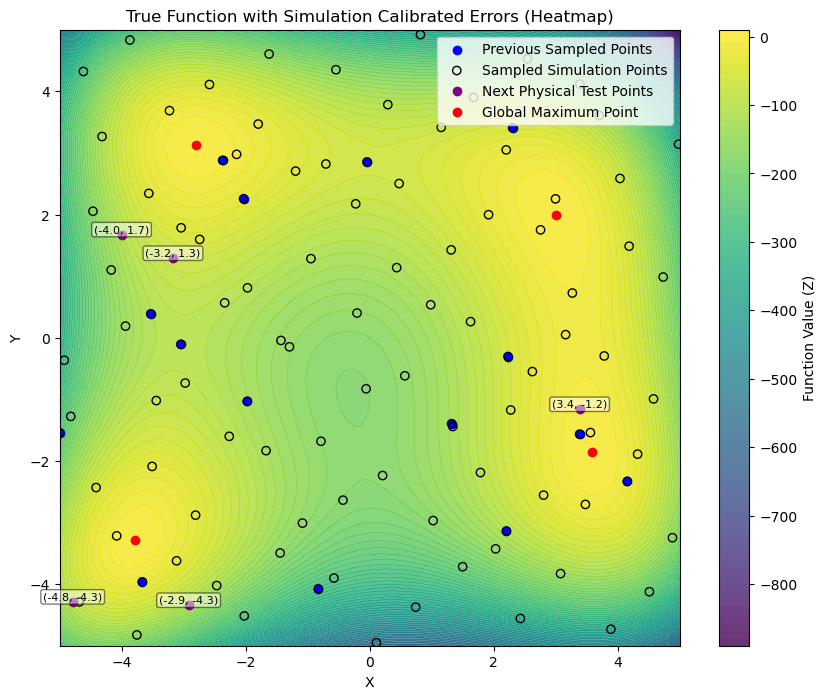

Selected 5 new test points. Median diff: -0.0204
[Iteration 2] RMSE: 0.2260, R²: 1.0000
[ 4.21912908 -3.32726765]


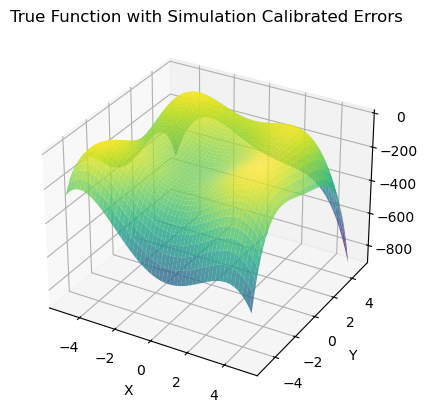

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 28102.8184
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 28073.6230
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 28040.7441
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 28002.6094
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 27950.7832
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 27886.0371
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 27806.5938
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 27699.4219
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 27543.4453
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 27264.2773
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 27032.6914
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 26659.8633
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 26095.7031
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 25449.3945
Epoch 15/500
1/1 ━━━━━━━━━━━━━━

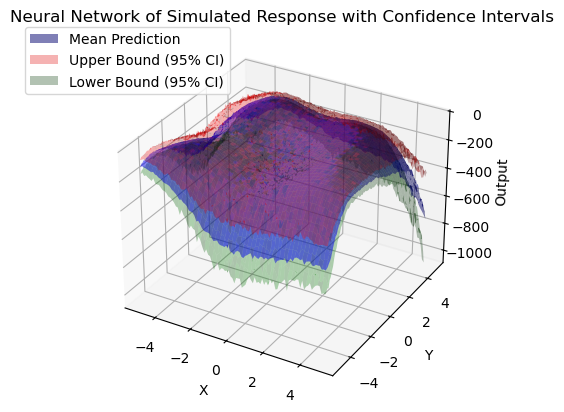

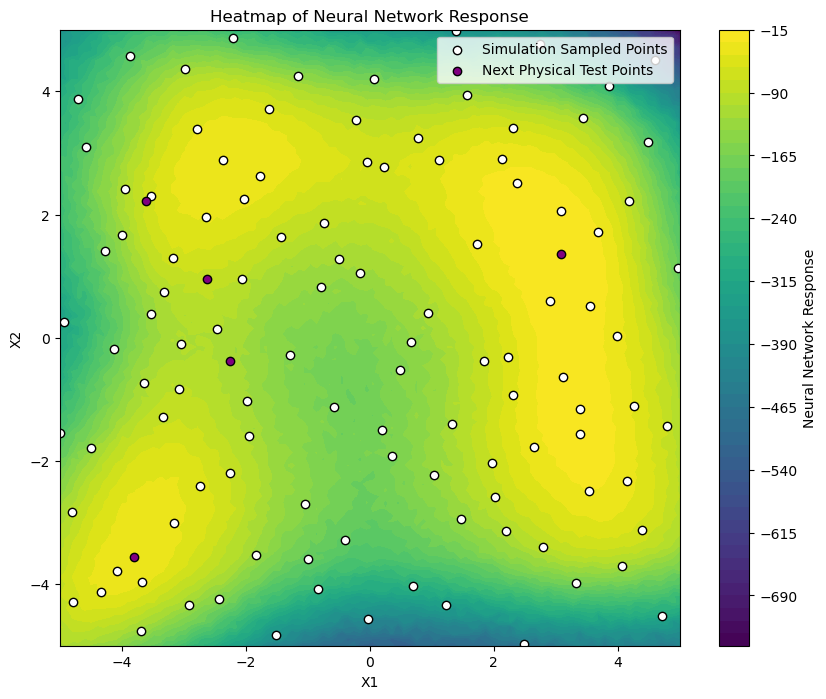

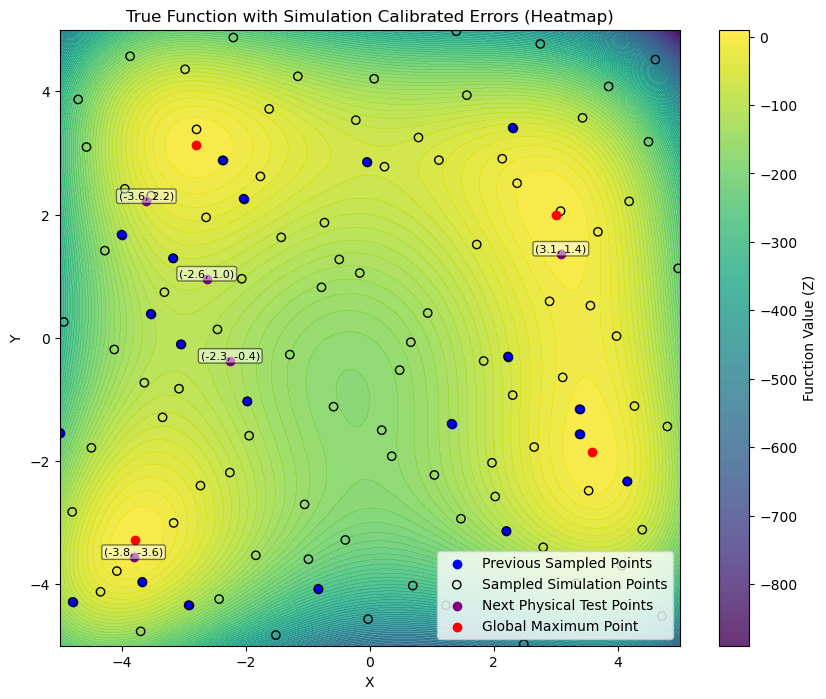

Selected 5 new test points. Median diff: 0.0418
[Iteration 3] RMSE: 1.7093, R²: 0.9994
[ 4.17309971 -3.28890211]


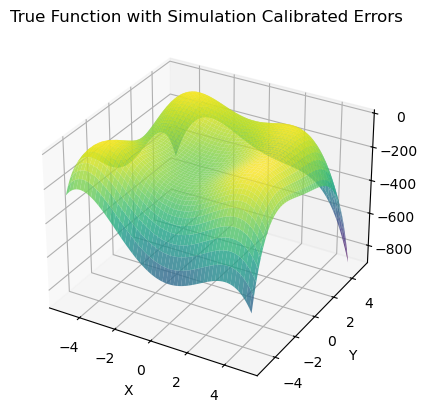

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 27737.9746
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 27707.6367
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 27663.9062
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 27624.7422
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 27536.4961
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 27436.2617
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 27293.9180
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 27137.1699
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 26892.8730
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 26502.2715
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 26058.5215
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 25436.9727
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 24484.9238
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 23315.3027
Epoch 15/500
1/1 ━━━━━━━━━━━━━━

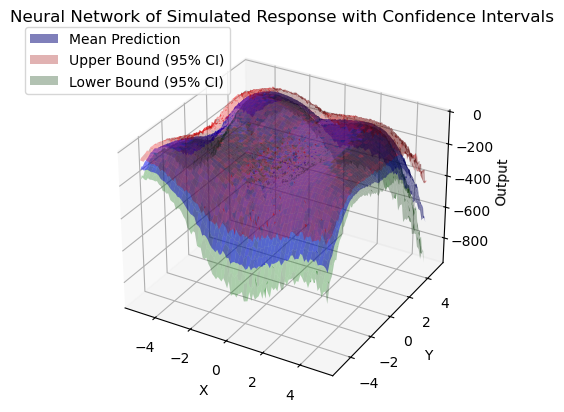

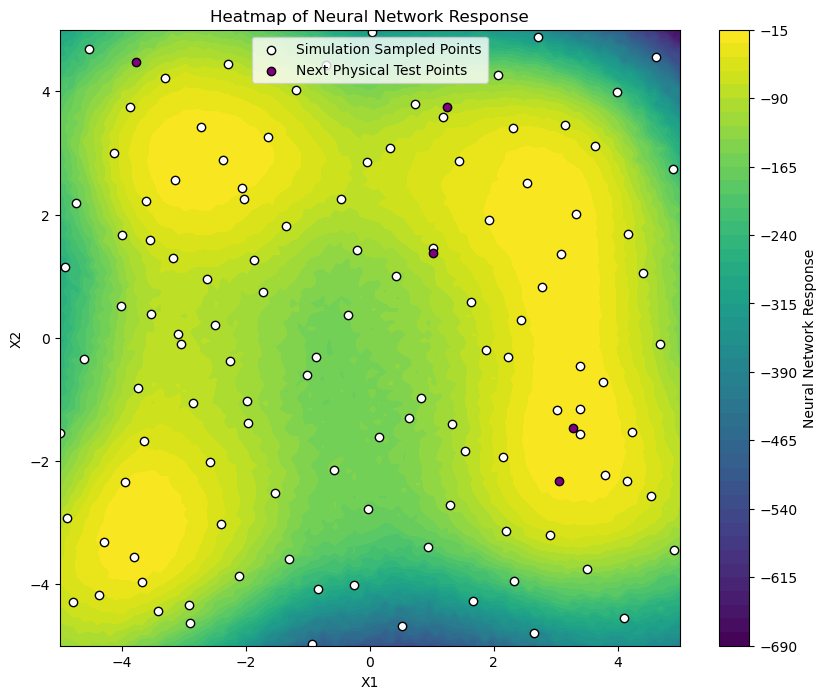

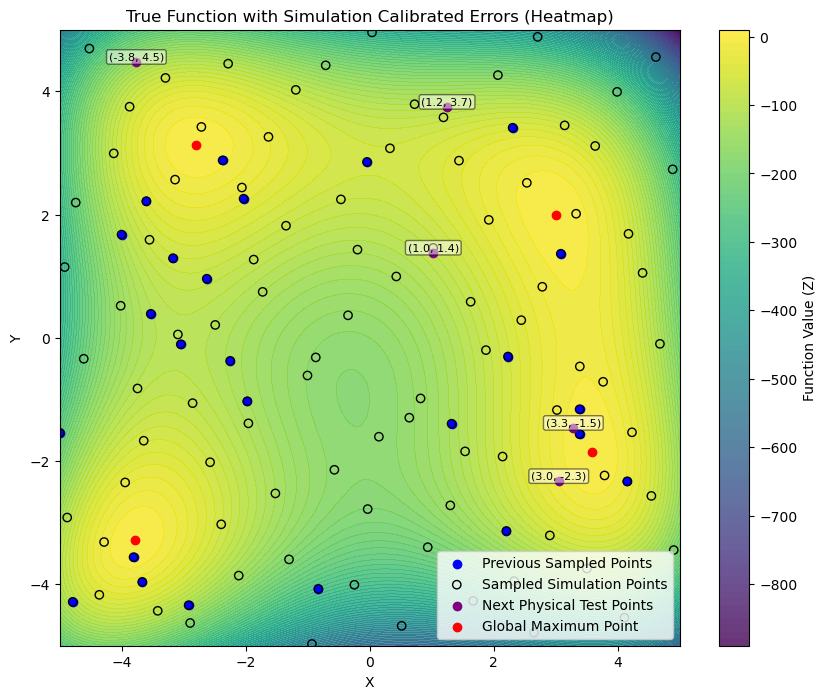

Selected 5 new test points. Median diff: 0.1650
[Iteration 4] RMSE: 2.6699, R²: 0.9984
[ 4.2014737  -3.22290585]


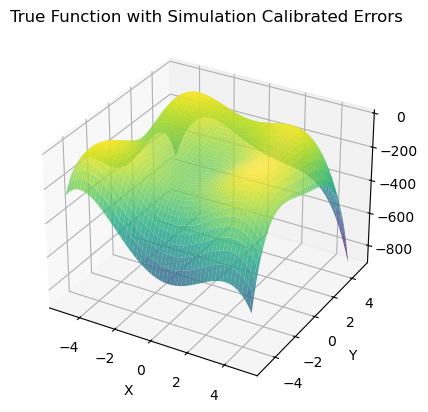

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 25125.5898
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 25095.5625
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 25068.4180
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 25024.0176
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 24987.1445
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 24924.4492
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 24859.9961
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 24762.9102
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 24580.4766
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 24409.6543
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 24137.0293
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 23724.8750
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 23235.3711
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 22583.5078
Epoch 15/500
1/1 ━━━━━━━━━━━━━━

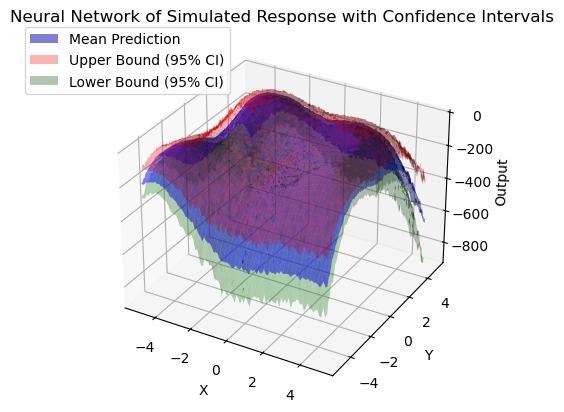

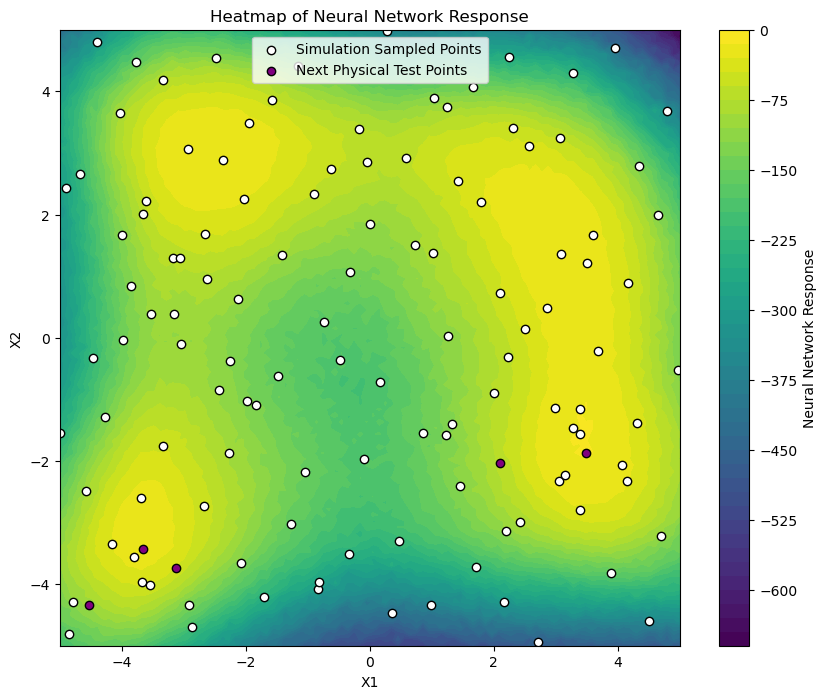

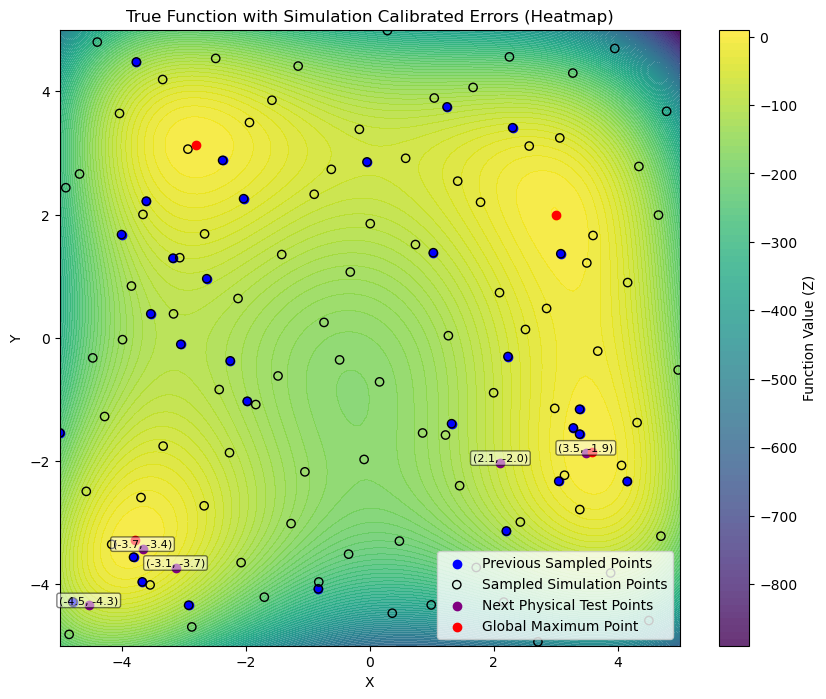

Selected 5 new test points. Median diff: -0.0891
[Iteration 5] RMSE: 0.2297, R²: 1.0000
[ 4.16587621 -3.24950967]


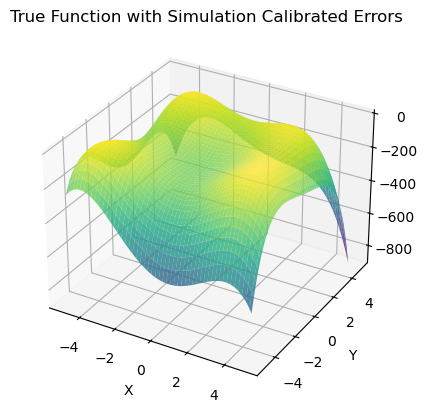

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 25439.7598
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 25405.5039
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 25380.0879
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 25334.5938
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 25273.6172
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 25176.0332
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 25059.8164
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 24897.5000
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 24615.7227
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 24331.6699
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 23937.8125
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 23362.0781
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 22796.5078
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 21598.8633
Epoch 15/500
1/1 ━━━━━━━━━━━━━━

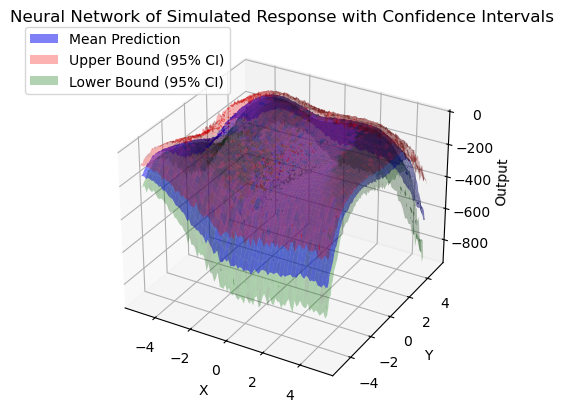

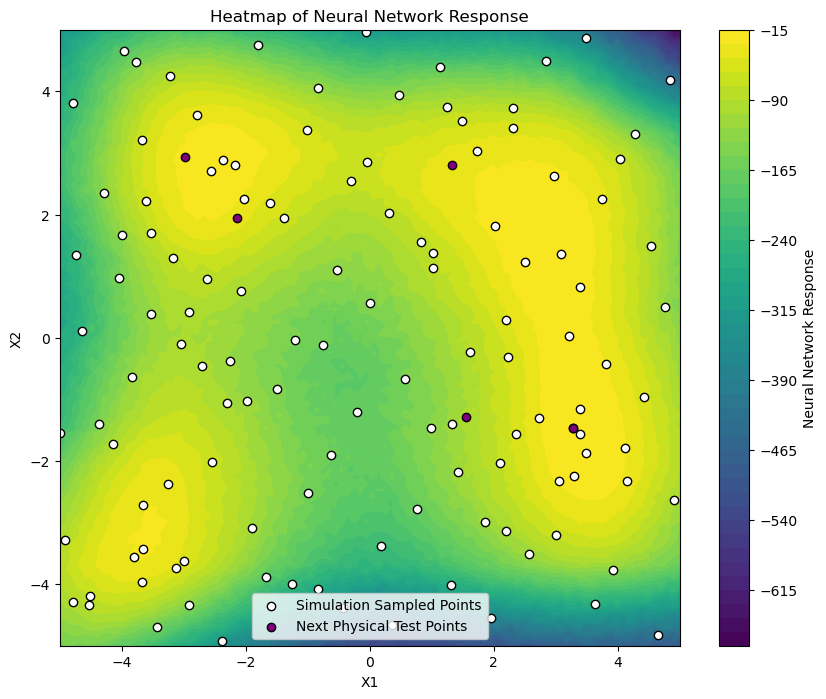

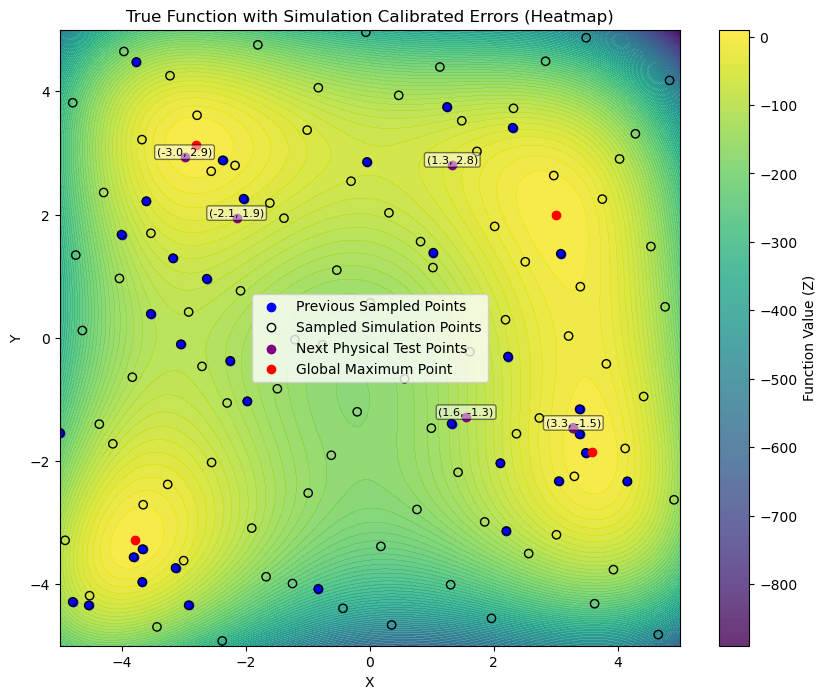

Selected 5 new test points. Median diff: 0.1569
[Iteration 6] RMSE: 0.5709, R²: 0.9999

=== Running with 10 physical experiments ===
[ 3.94532989 -2.84518803]


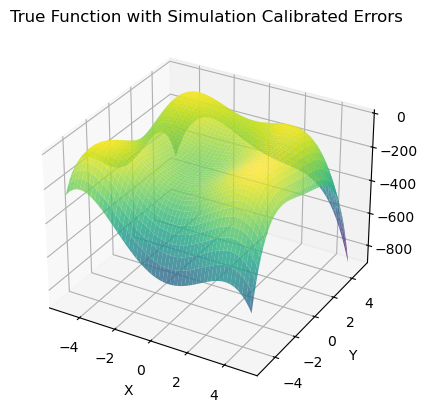

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 29678.4609
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 29636.7207
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 29578.2266
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 29492.3555
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 29400.0234
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 29236.2559
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 29010.8301
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 28758.9980
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 28351.7891
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 27869.3359
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 27300.9258
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 26266.9121
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 25302.6641
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 23550.0742
Epoch 15/500
1/1 ━━━━━━━━━━━━━━

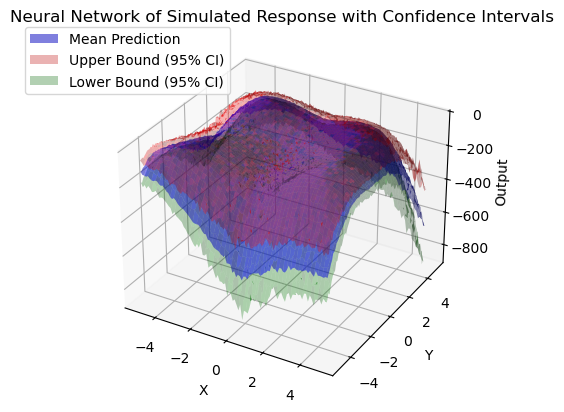

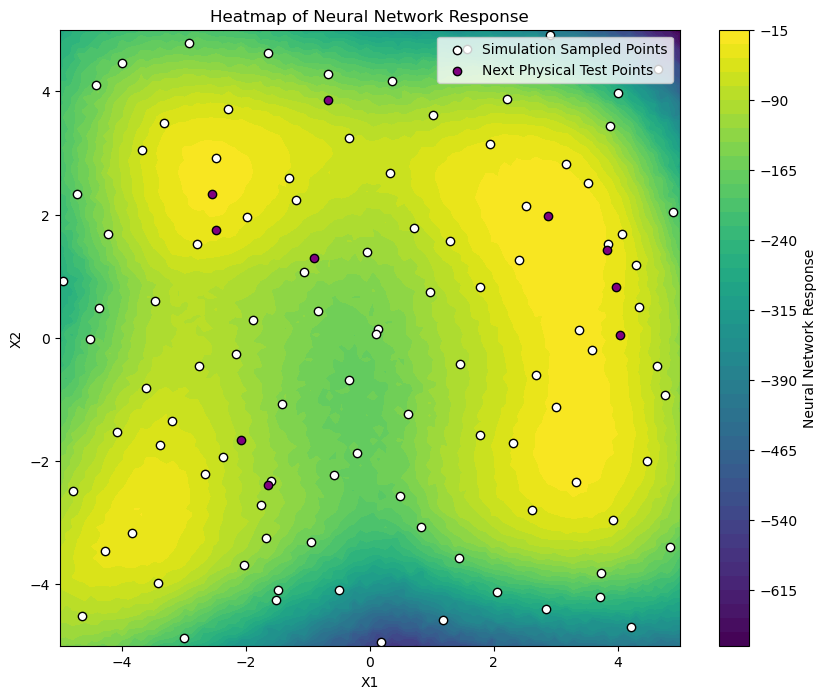

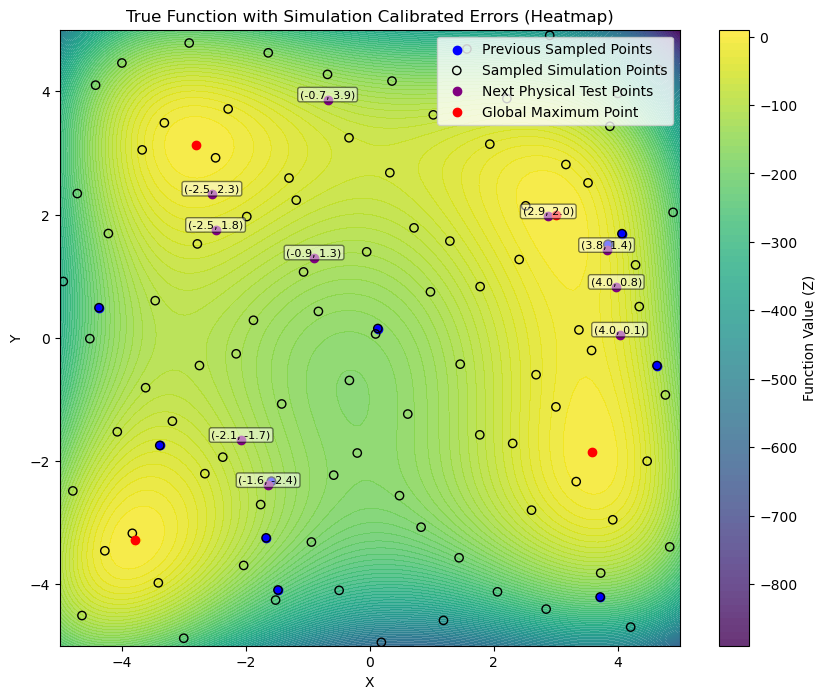

Selected 10 new test points. Median diff: -0.0763
[Iteration 0] RMSE: 0.1643, R²: 1.0000
[ 3.98898281 -2.78876824]


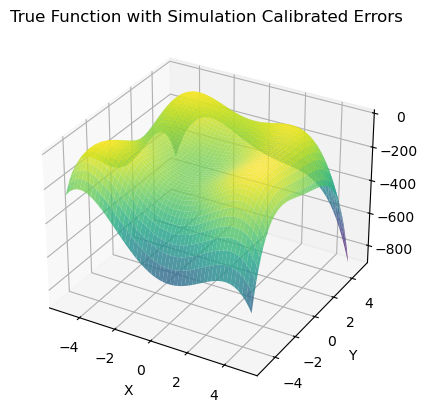

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 27548.2109
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 27515.7168
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 27470.7734
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 27421.9688
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 27355.9023
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 27244.2305
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 27095.3438
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 26929.5293
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 26598.1758
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 26273.9004
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 25898.7891
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - loss: 25291.6055
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 24284.0332
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 23216.7383
Epoch 15/500
1/1 ━━━━━━━━━━━━━━

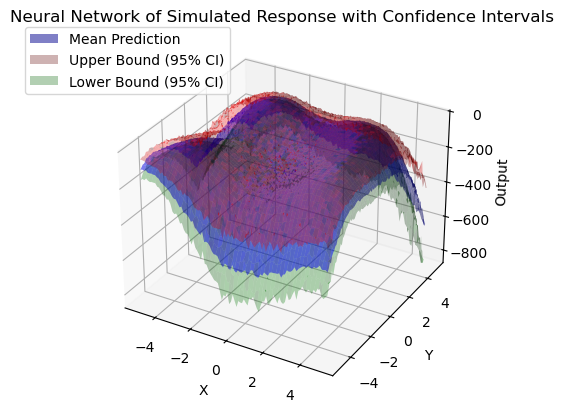

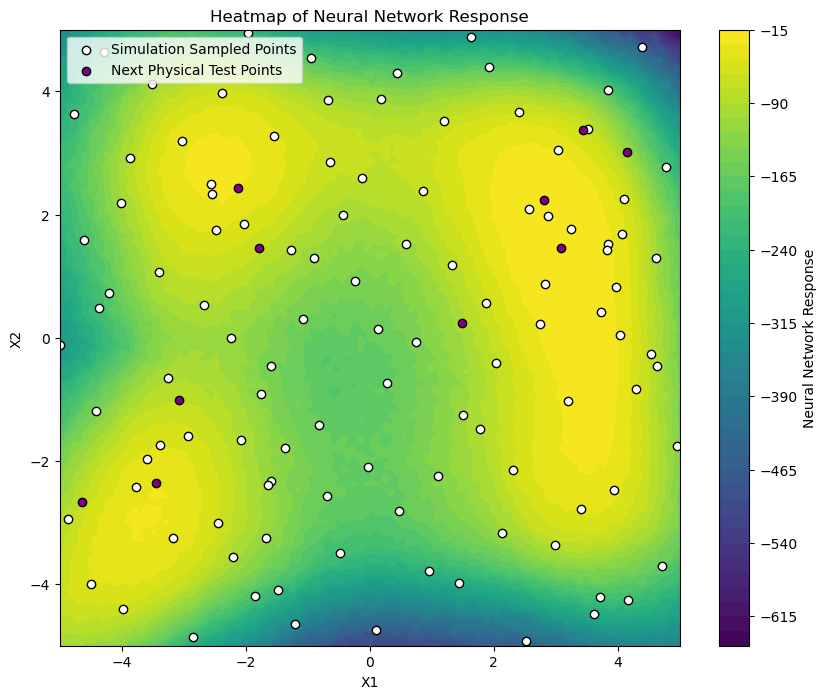

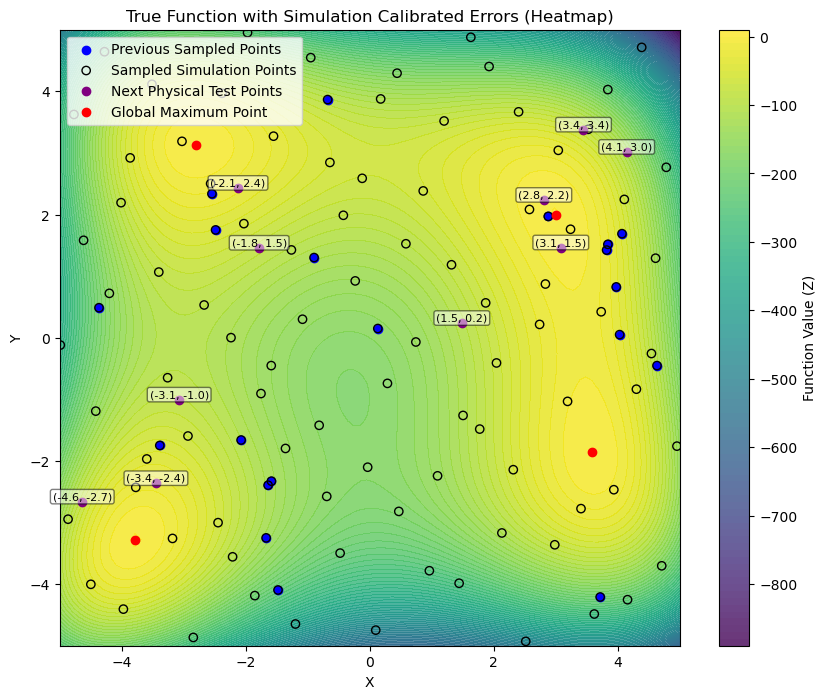

Selected 10 new test points. Median diff: -0.1884
[Iteration 1] RMSE: 0.2334, R²: 1.0000
[ 4.05828652 -3.03052582]


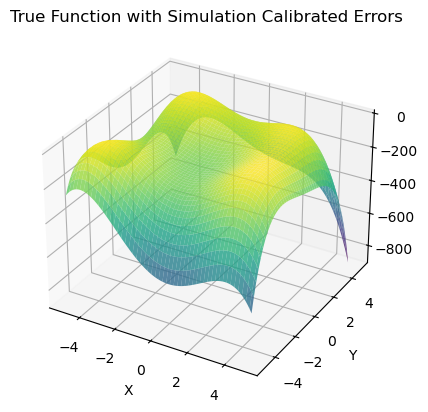

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 27470.9570
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 27434.4785
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 27402.5840
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 27351.7988
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 27297.7090
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 27213.2324
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 27134.8105
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 26938.3066
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 26681.8867
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 26336.0254
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 26012.3477
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 25419.3301
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 24614.6367
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 23624.4180
Epoch 15/500
1/1 ━━━━━━━━━━━━━━

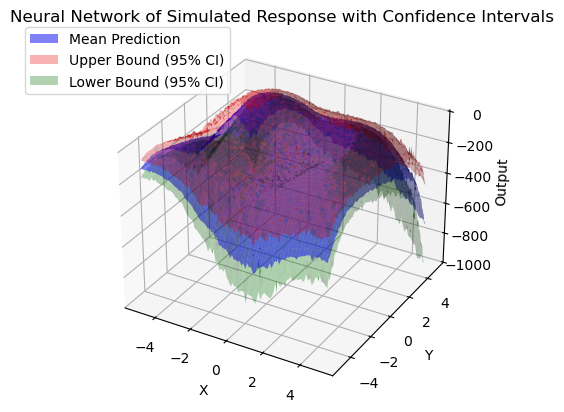

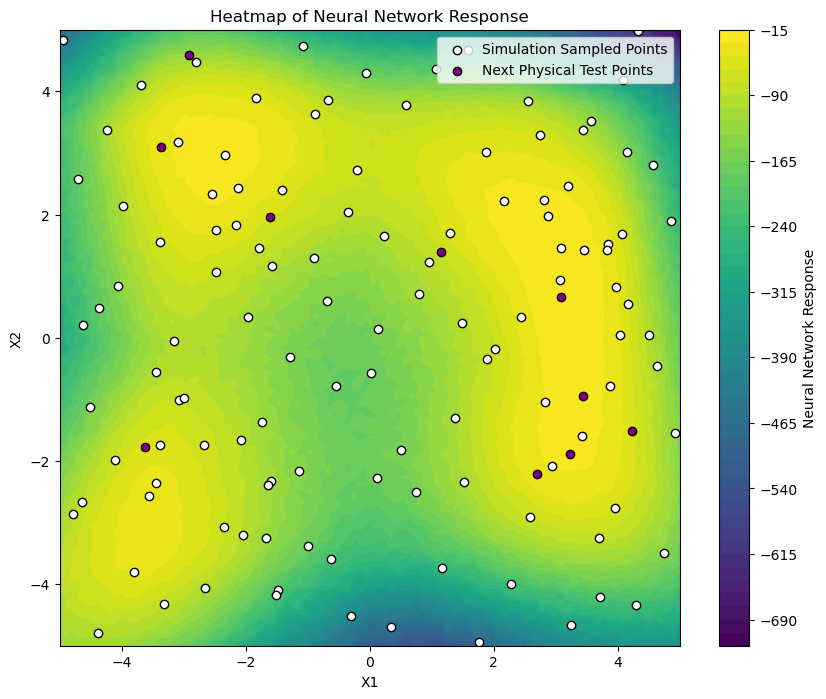

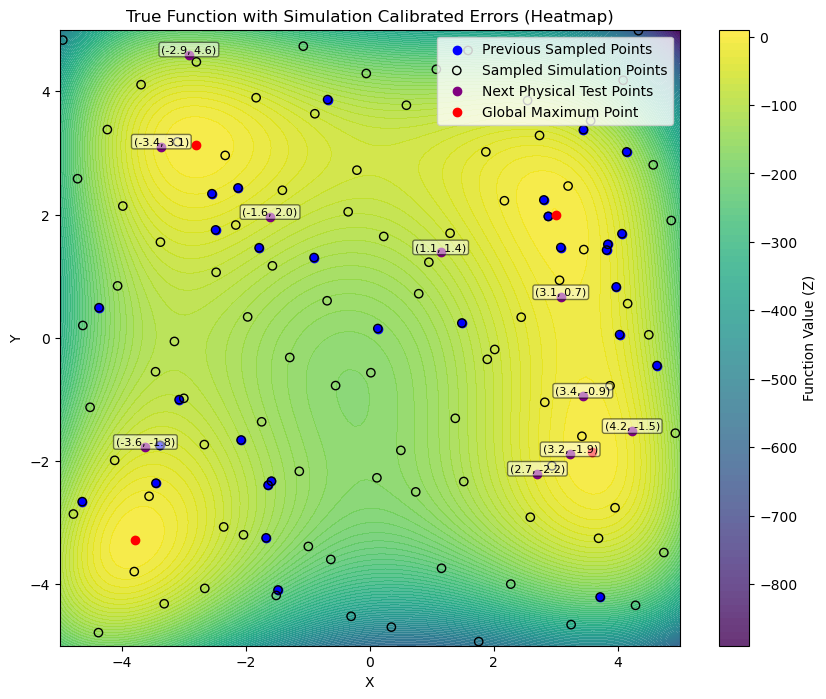

Selected 10 new test points. Median diff: 0.0799
[Iteration 2] RMSE: 0.1963, R²: 1.0000
[ 4.04326875 -2.90912976]


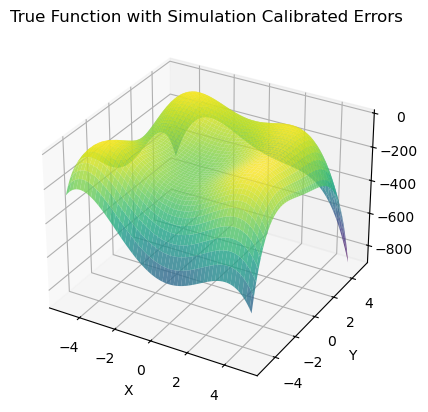

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 23650.6797
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 23624.5430
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 23582.9531
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 23533.8223
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 23448.8672
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 23343.7266
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 23242.1270
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 23032.4297
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 22812.2363
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 22376.4609
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 21958.0176
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 21310.9004
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 20362.3633
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 19382.2129
Epoch 15/500
1/1 ━━━━━━━━━━━━━━

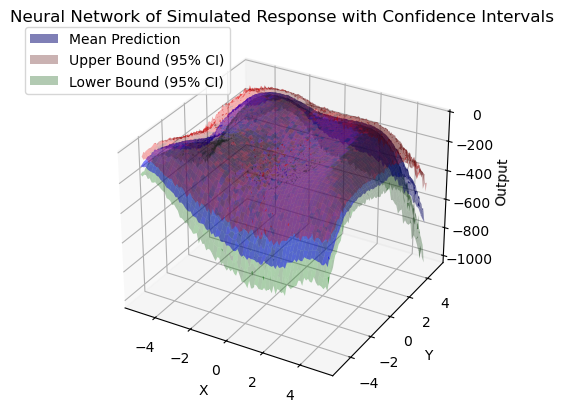

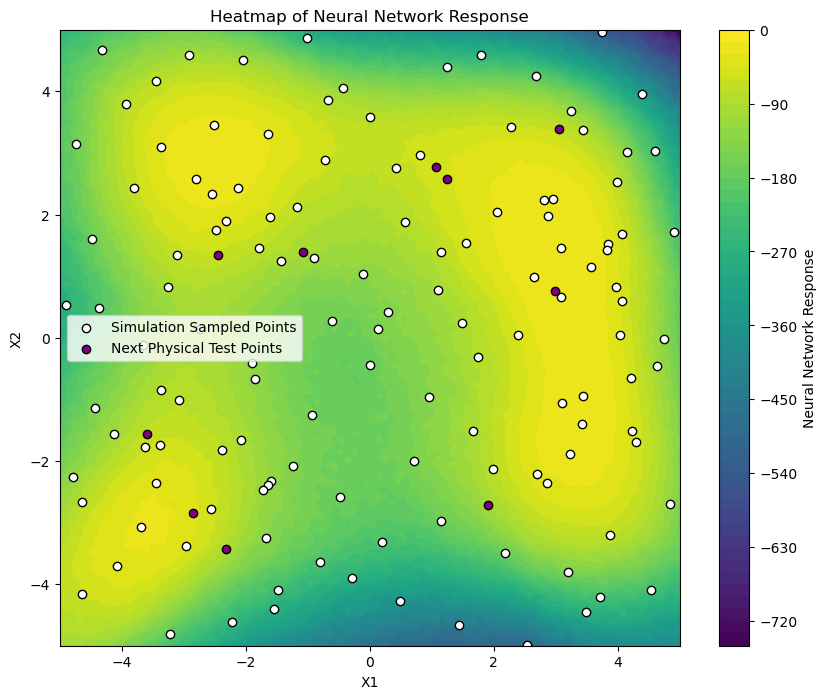

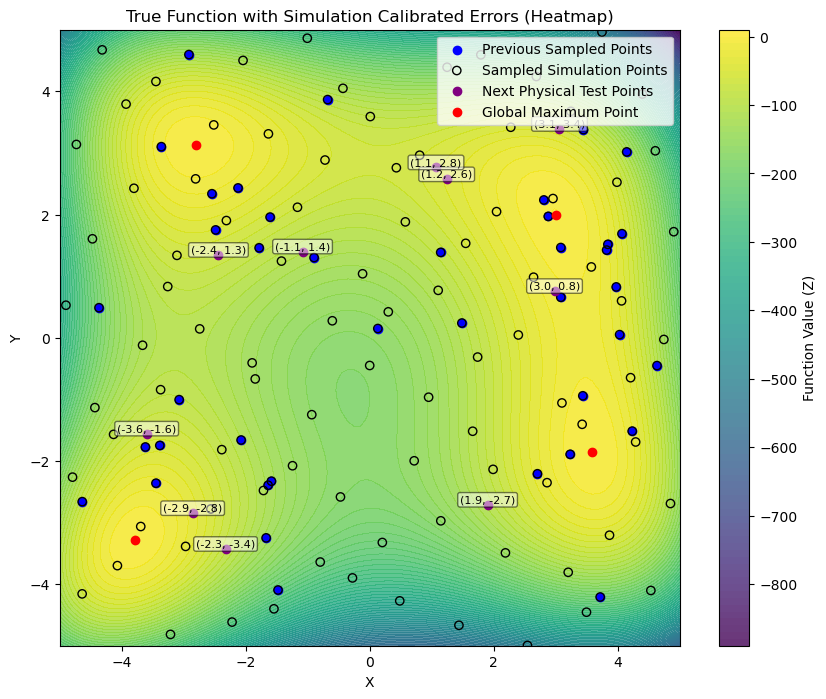

Selected 10 new test points. Median diff: -0.1616
[Iteration 3] RMSE: 0.2016, R²: 1.0000
[ 3.98149809 -2.99488259]


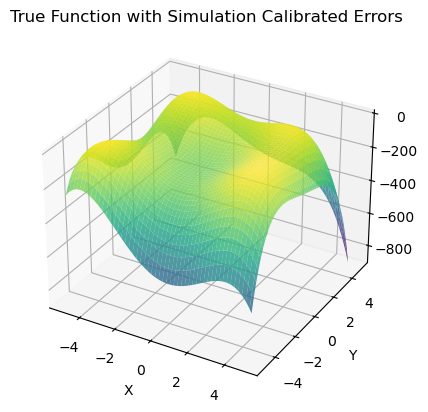

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 22454.6133
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 22423.3574
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 22381.4258
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 22345.9141
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 22286.8184
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 22176.5977
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 22075.8848
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 21885.6738
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 21679.7344
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 21353.0176
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 20902.6465
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - loss: 20383.5449
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 19599.4863
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 18528.3926
Epoch 15/500
1/1 ━━━━━━━━━━━━━━

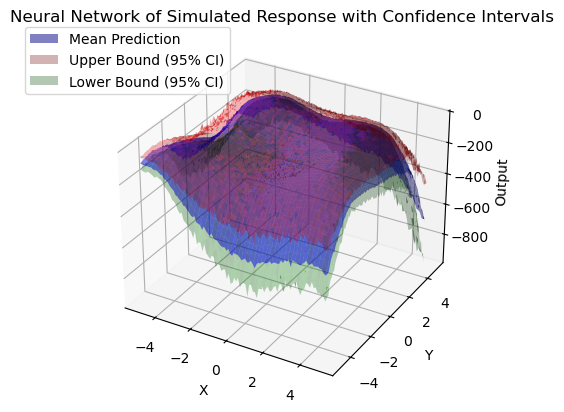

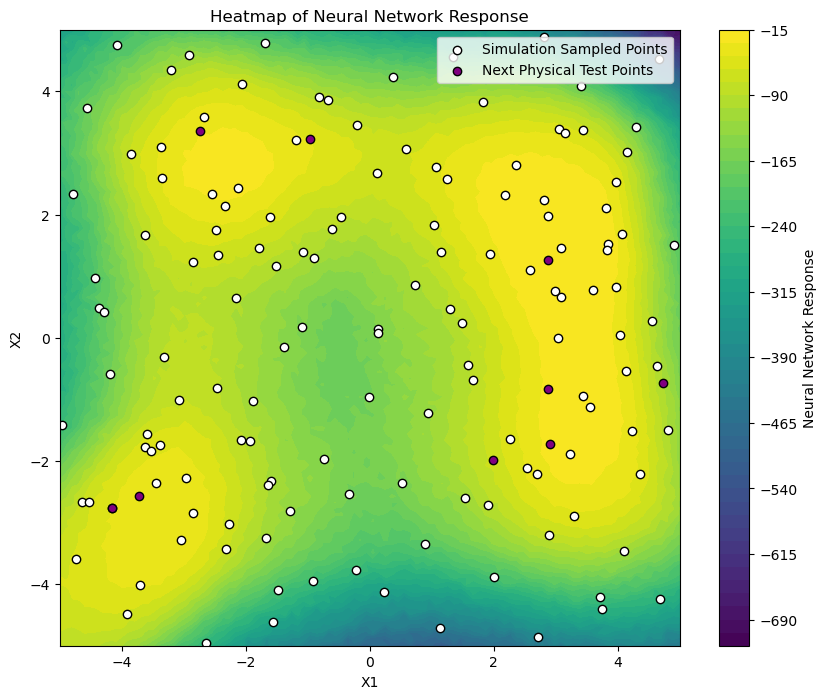

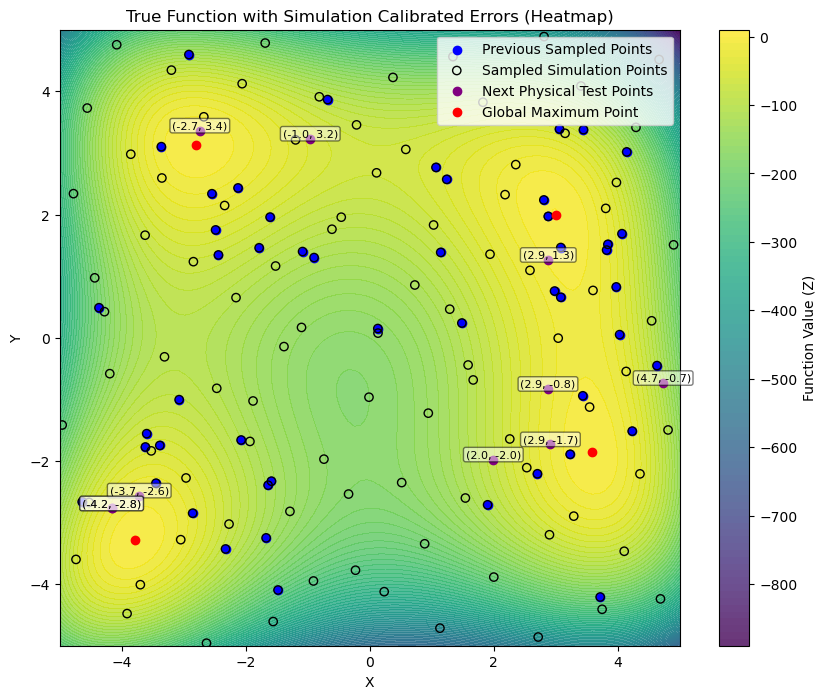

Selected 10 new test points. Median diff: 0.0481
[Iteration 4] RMSE: 0.7153, R²: 0.9998
[ 3.99968073 -2.98990419]


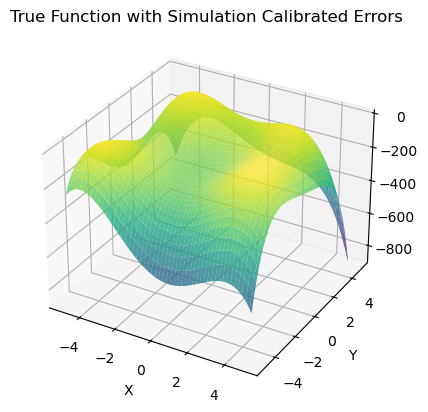

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step - loss: 21416.4043
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 21392.8516
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 21359.2422
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 21319.5566
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 21252.6602
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 21187.4043
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 21067.4922
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 20899.3047
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 20742.2227
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 20395.1250
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 20017.8789
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 19592.0059
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 18919.8457
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 17756.0137
Epoch 15/500
1/1 ━━━━━━━━━━━━━━

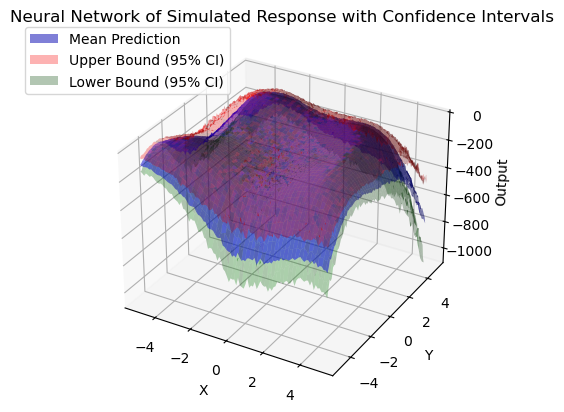

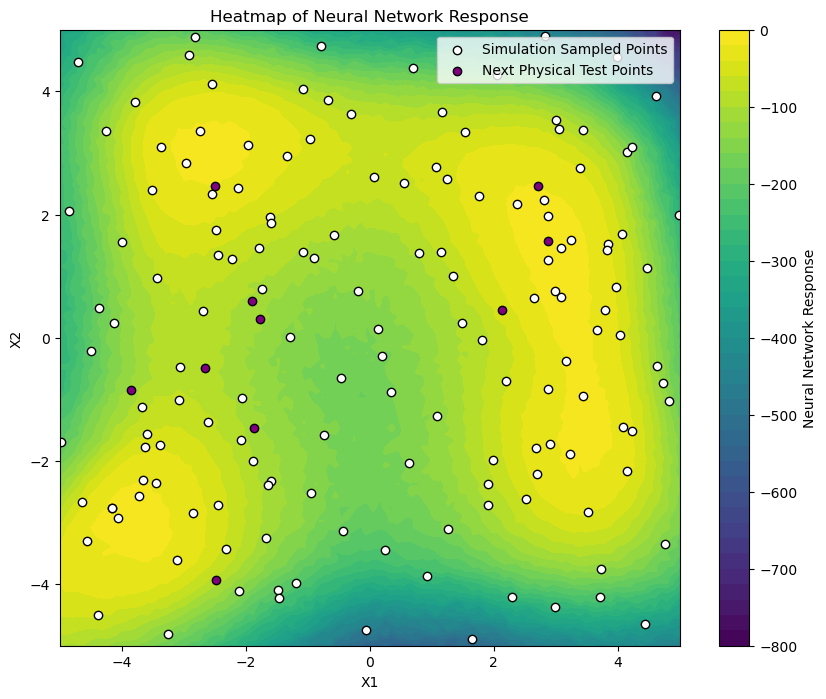

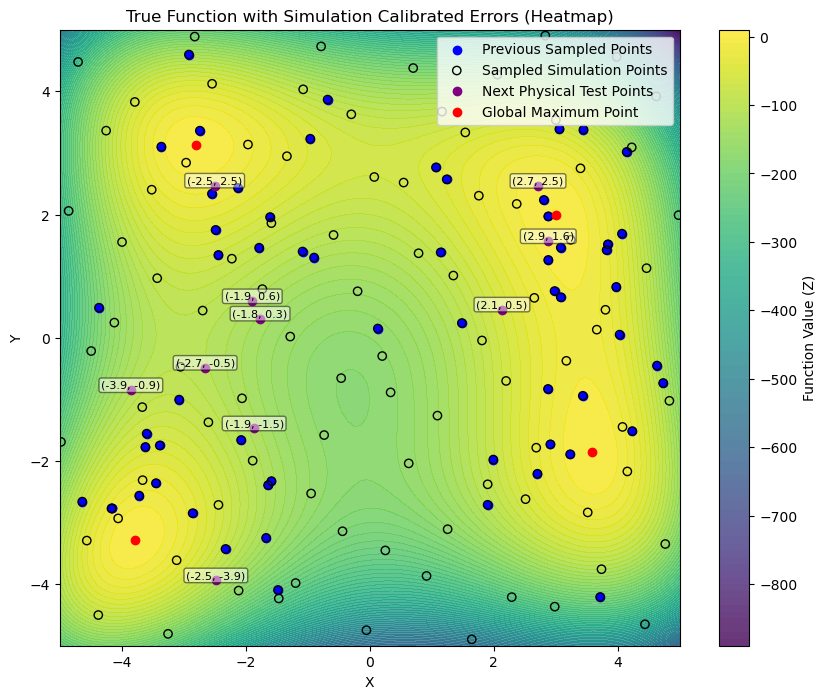

Selected 10 new test points. Median diff: -0.0734
[Iteration 5] RMSE: 0.2216, R²: 1.0000
[ 3.95245065 -3.00771315]


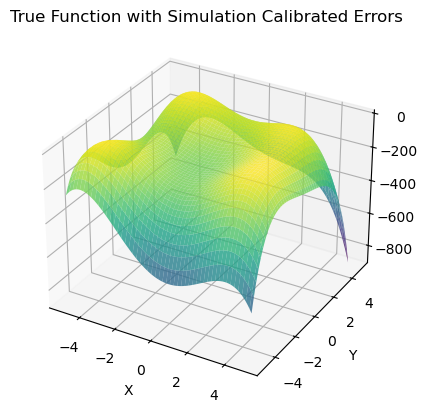

Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 19393.3516
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 19619.0820 
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 19417.8691 
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 19737.7266 
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 19336.5859 
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 18762.0312 
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 18743.6895 
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 18047.0215
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 17021.8418 
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 15060.2207 
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 12412.4580 
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 9177.3262 
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8584.4688 
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 10304.1338 
Epoch 15/500
2/2 ━━━━━━━━━━━━━━━

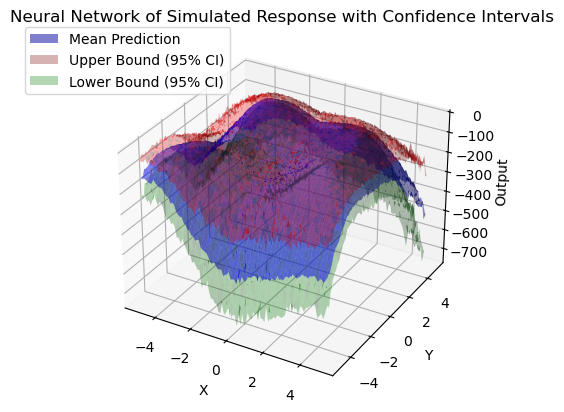

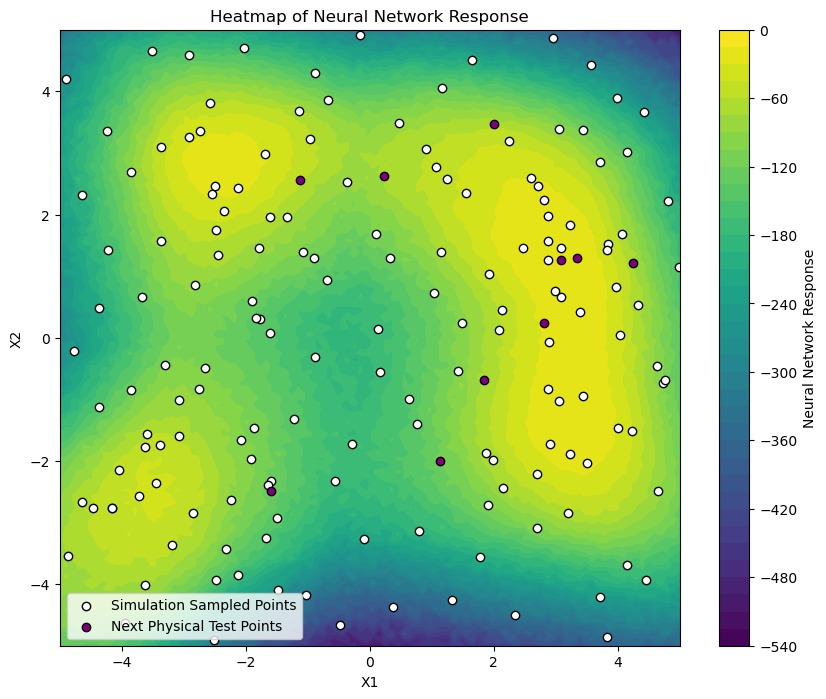

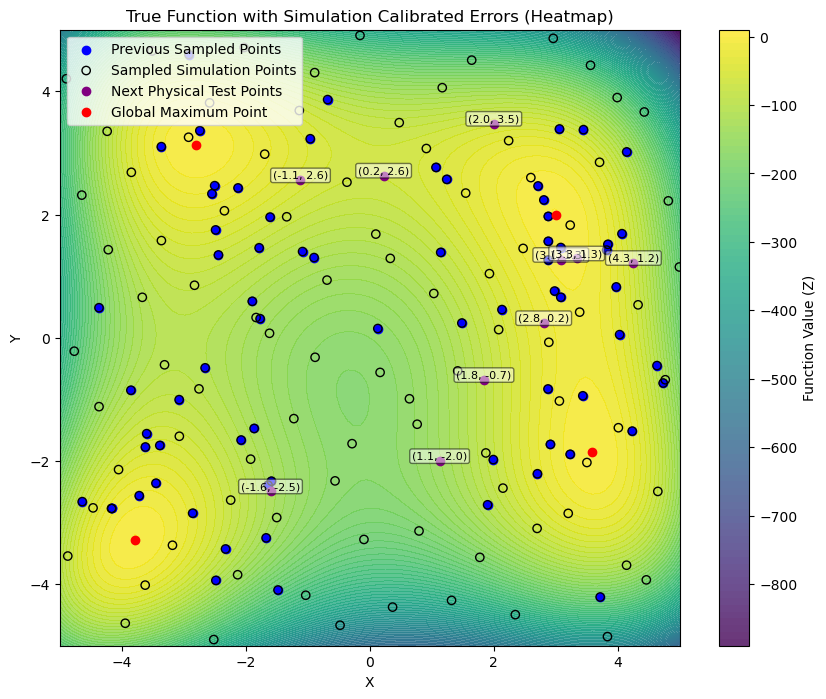

Selected 10 new test points. Median diff: -0.0319
[Iteration 6] RMSE: 0.2042, R²: 1.0000

=== Running with 15 physical experiments ===
[ 3.88421139 -3.0401113 ]


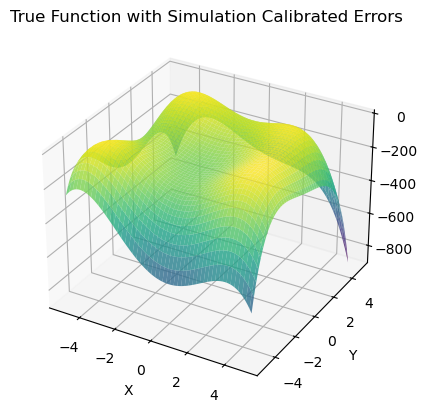

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 35448.5078
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step - loss: 35412.8945
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 35389.7969
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 35356.6875
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 35299.9570
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 35240.9492
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 35155.5156
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 35049.8594
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 34890.6953
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 34659.3125
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 34409.9727
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 33950.5859
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 33446.3555
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 32638.9883
Epoch 15/500
1/1 ━━━━━━━━━━━━━━

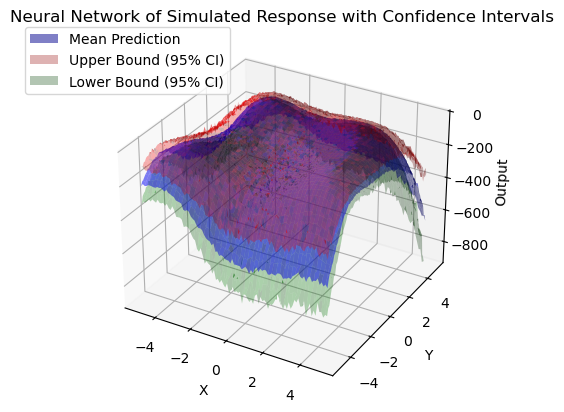

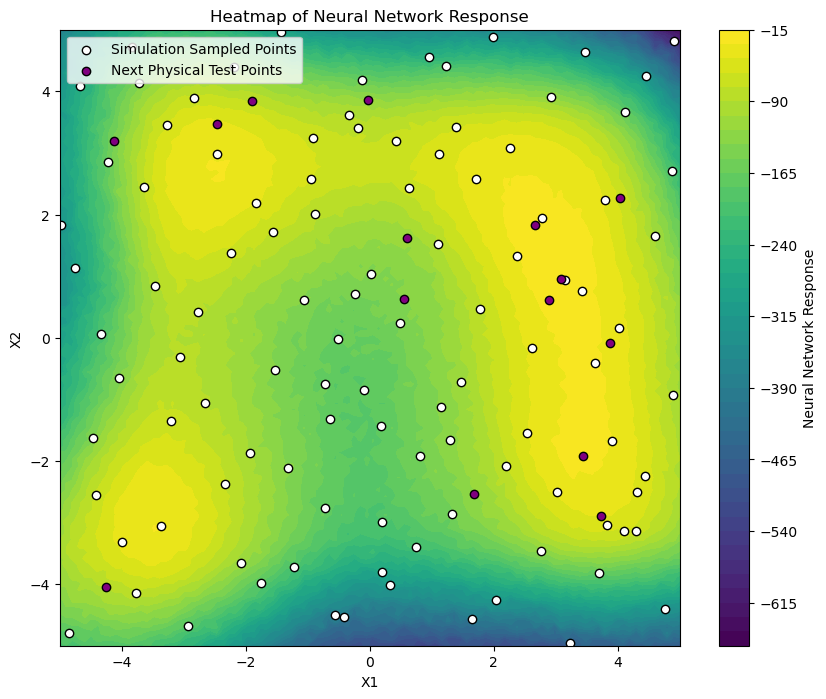

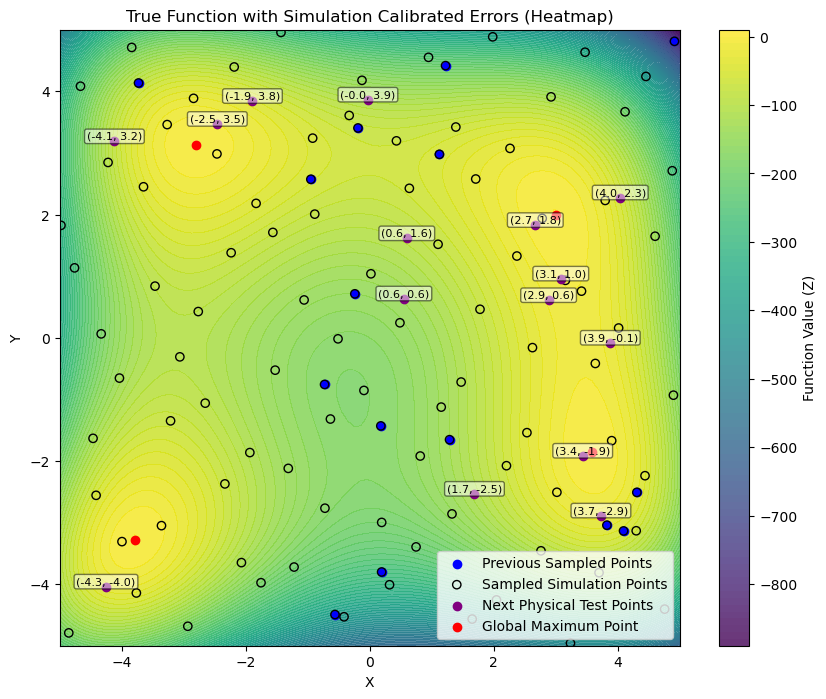

Selected 15 new test points. Median diff: 0.0578
[Iteration 0] RMSE: 1.1652, R²: 0.9999
[ 3.96909016 -3.02815877]


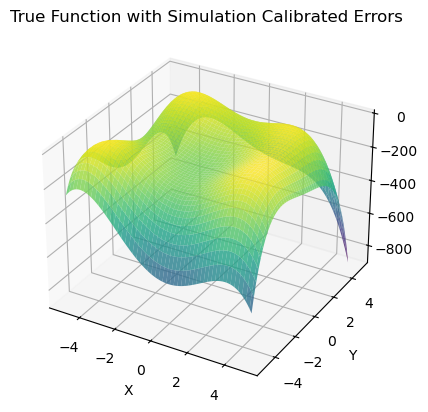

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 32178.5430
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 32128.8867
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 32100.5762
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 32073.7949
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 32033.4375
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 31968.1055
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 31881.4707
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 31757.9707
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 31589.9824
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 31376.2793
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 31047.0430
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 30688.7070
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 30056.4473
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 29362.4238
Epoch 15/500
1/1 ━━━━━━━━━━━━━━

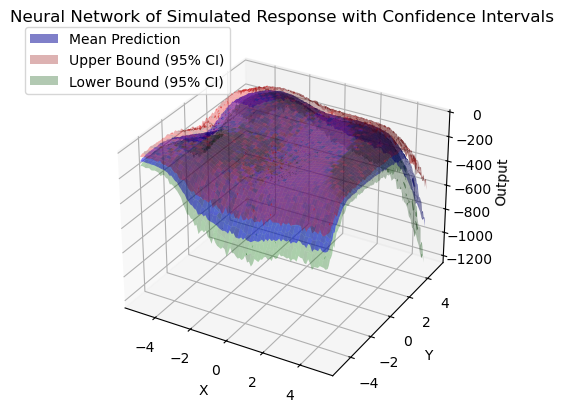

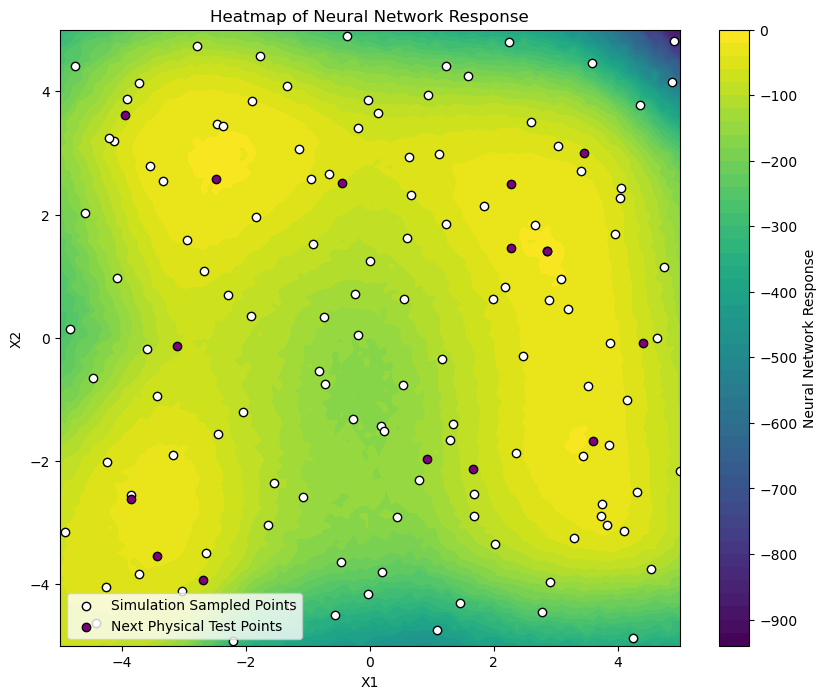

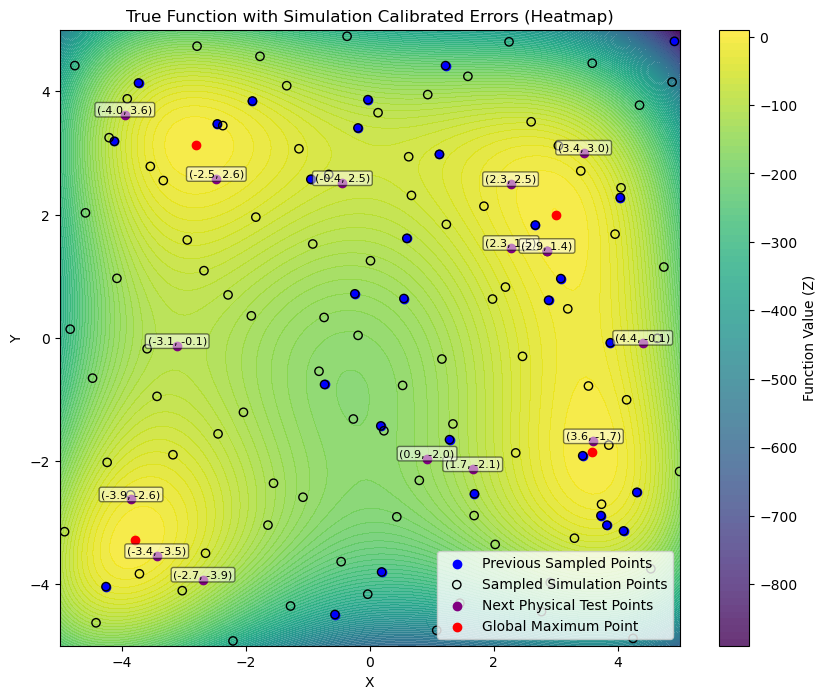

Selected 15 new test points. Median diff: -0.0094
[Iteration 1] RMSE: 0.2720, R²: 1.0000
[ 4.02887749 -3.03396005]


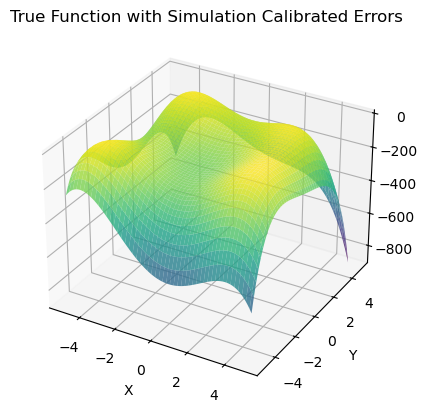

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 27949.3672
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 27907.5039
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 27852.2676
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 27788.7871
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 27712.8086
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 27578.9219
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 27428.4004
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 27169.2500
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 26768.8906
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 26398.2402
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 25946.5117
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 25106.8828
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 24014.0977
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 22462.6270
Epoch 15/500
1/1 ━━━━━━━━━━━━━━

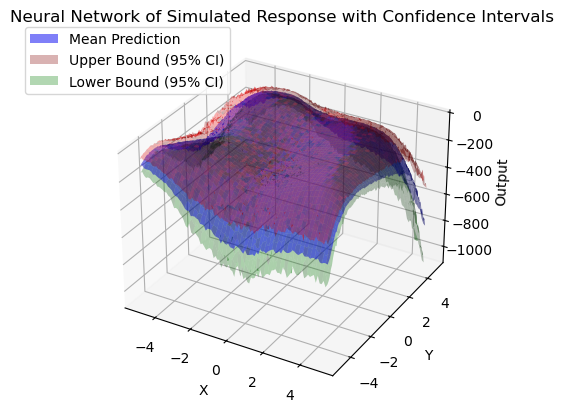

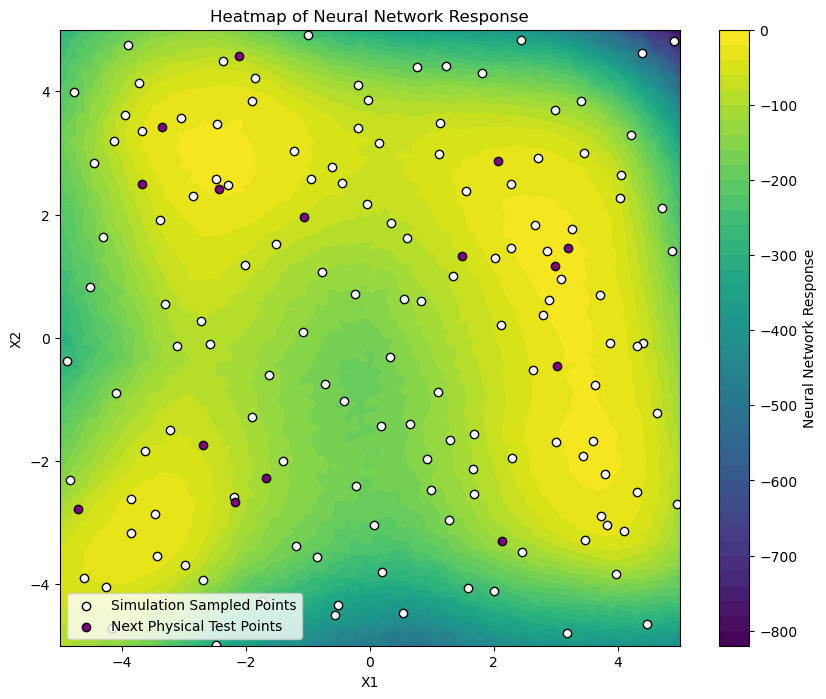

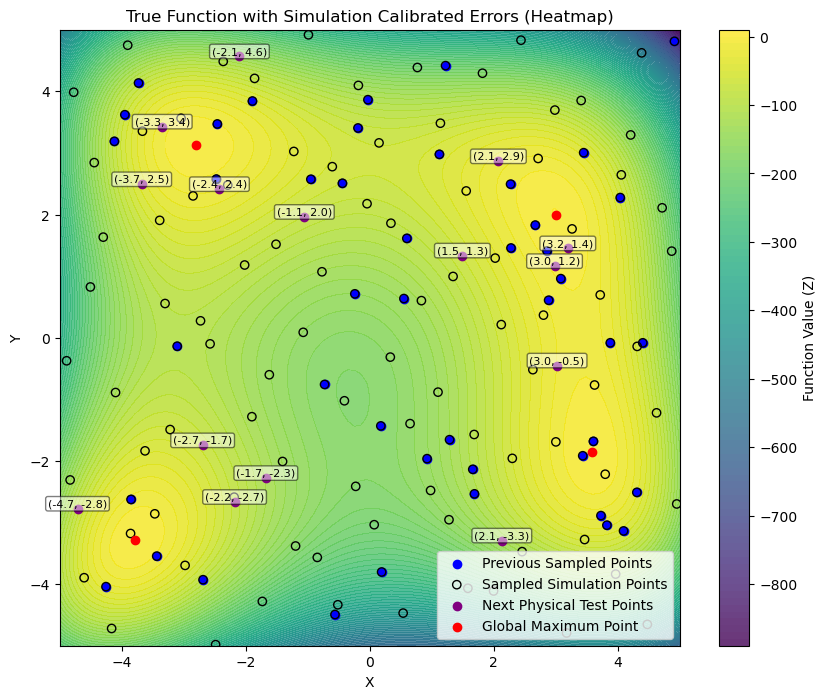

Selected 15 new test points. Median diff: -0.0618
[Iteration 2] RMSE: 0.3448, R²: 1.0000
[ 3.98692814 -3.01033086]


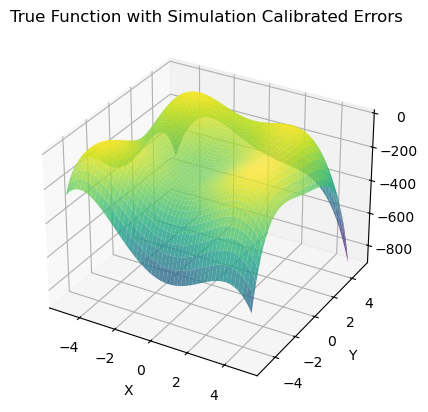

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 25770.3691
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 25748.0234
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 25719.0137
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 25692.1152
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 25650.5547
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 25602.8359
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 25510.1270
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 25416.9727
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 25271.2871
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 25101.1387
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 24817.0762
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 24485.8711
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 24067.9238
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 23373.5918
Epoch 15/500
1/1 ━━━━━━━━━━━━━━

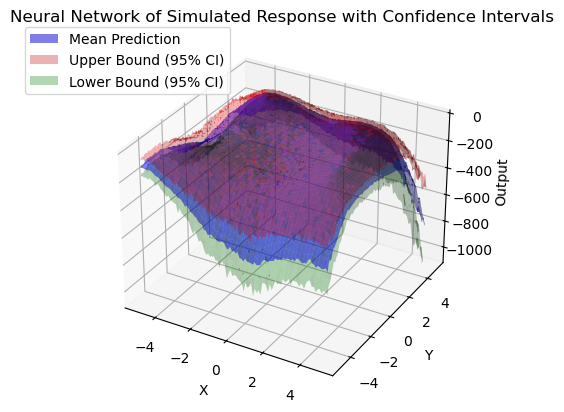

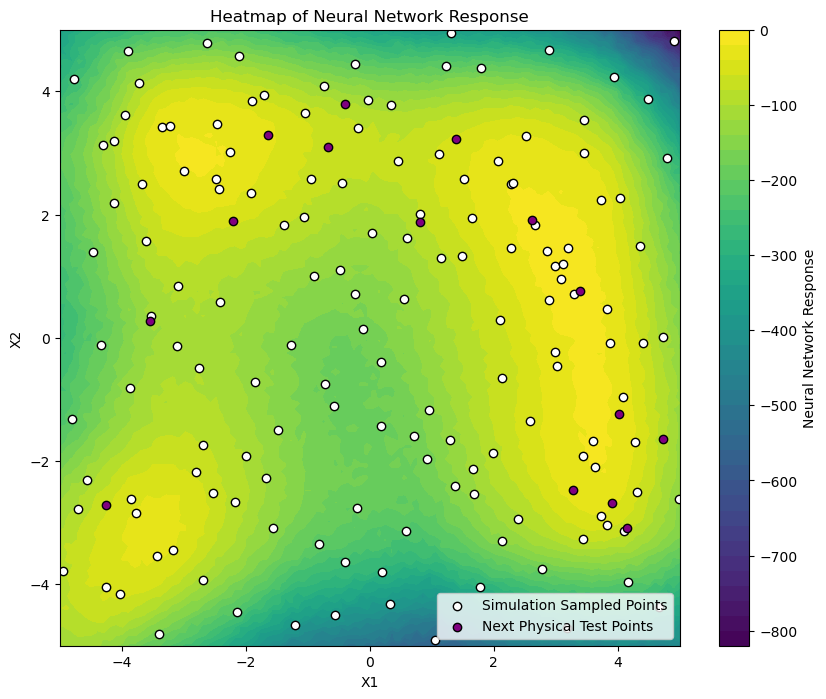

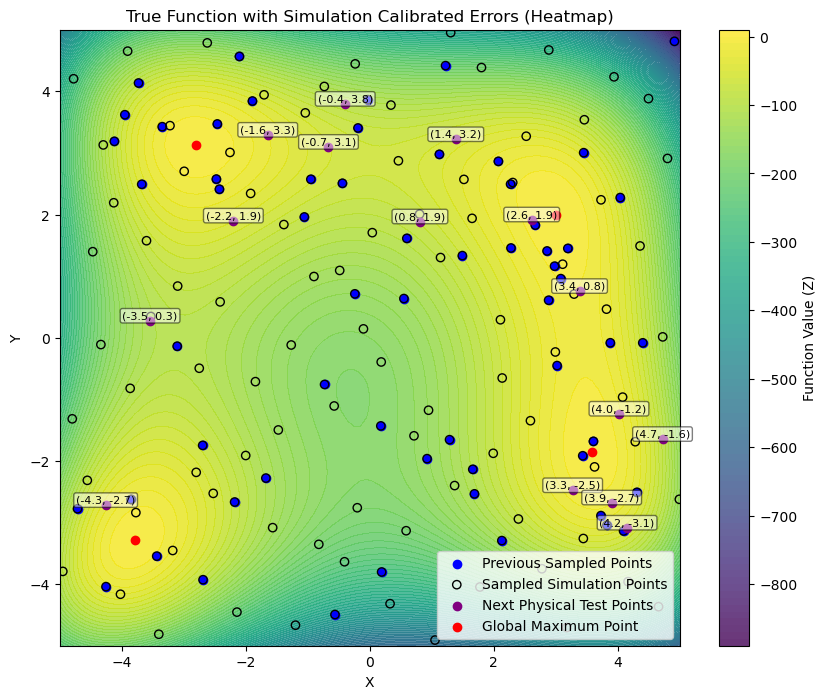

Selected 15 new test points. Median diff: 0.1250
[Iteration 3] RMSE: 0.2614, R²: 1.0000
[ 4.08930669 -3.0635041 ]


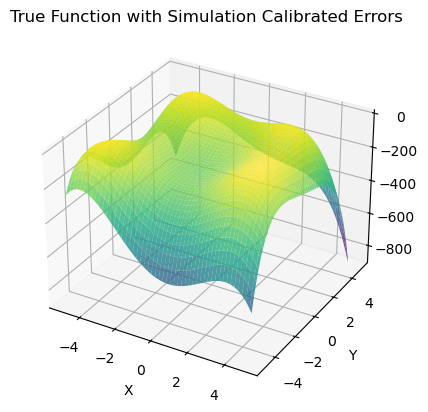

Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 25351.8848
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 24750.5996 
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 25209.4336 
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 24487.3691 
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 24585.7910 
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 24186.7852 
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 23984.6855 
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 22128.6934 
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 20641.3574 
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 18872.1973 
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 14764.0117 
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 11985.4648 
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 12551.7891 
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 13421.8135 
Epoch 15/500
2/2 ━━━━━━━━━━━━━

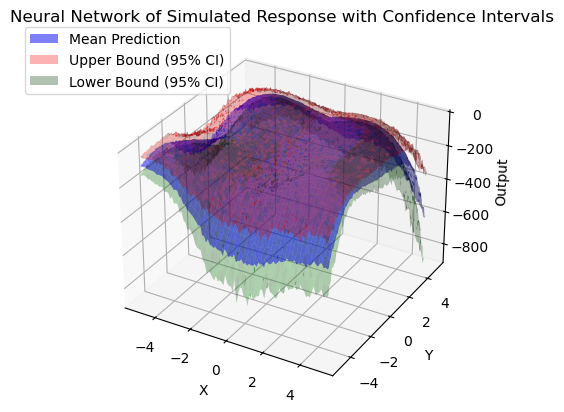

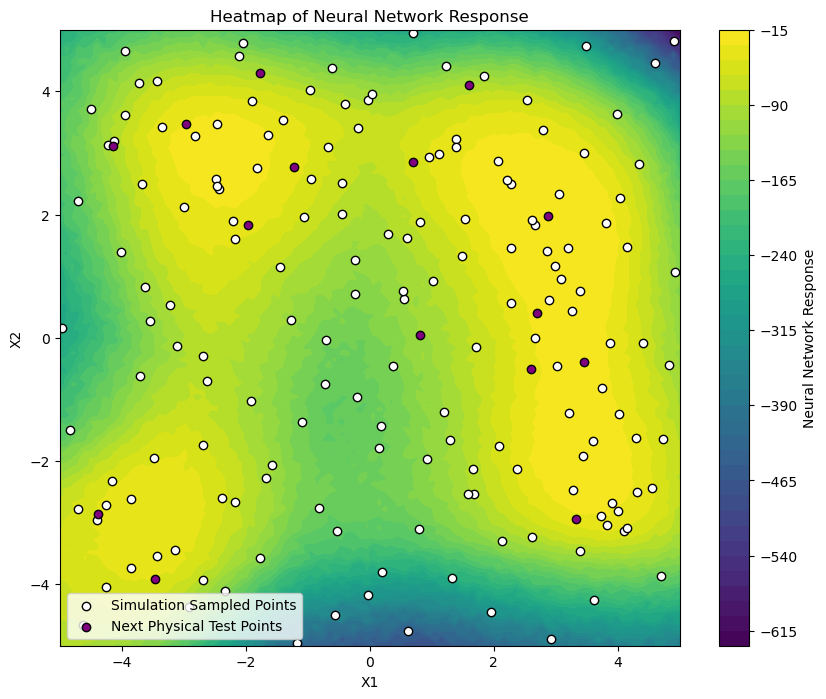

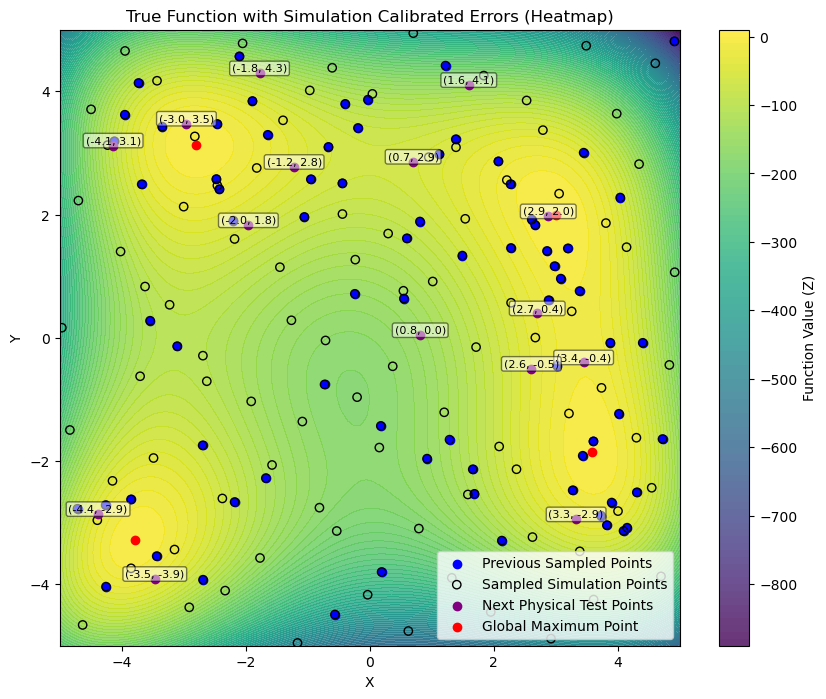

Selected 15 new test points. Median diff: 0.0265
[Iteration 4] RMSE: 0.9411, R²: 0.9999
[ 4.00884504 -3.02515518]


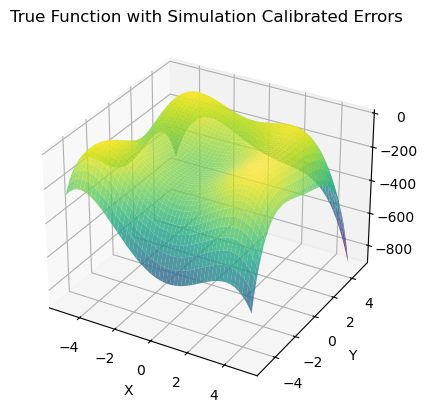

Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 23180.6406
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 23941.1895 
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 24129.6504 
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 23813.9375 
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 21580.1934 
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 22470.1230 
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 22671.8457 
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 20749.8496 
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 19250.3359 
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 16762.4570 
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 13492.9082 
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 11488.1621 
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 12845.5293 
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 12641.7939 
Epoch 15/500
2/2 ━━━━━━━━━━━━━

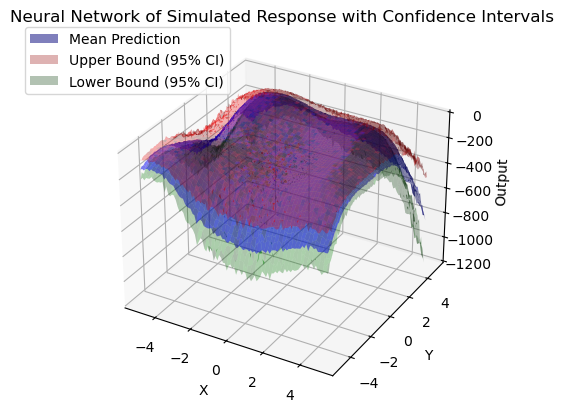

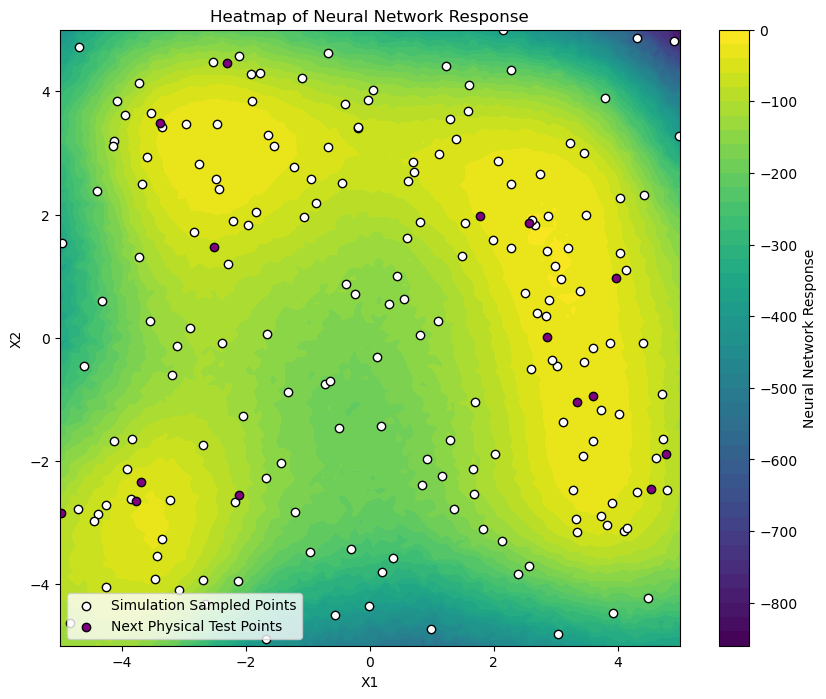

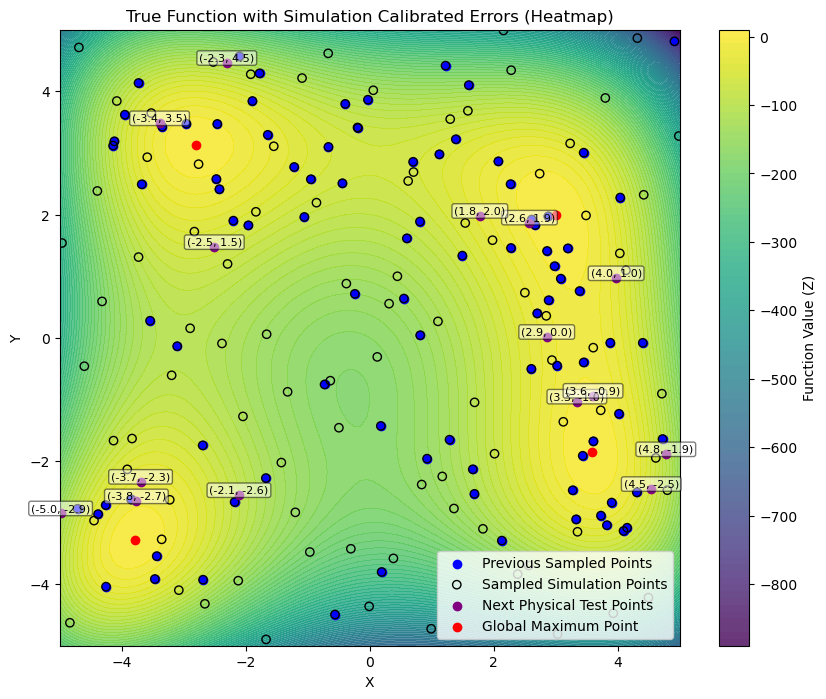

Selected 15 new test points. Median diff: -0.0234
[Iteration 5] RMSE: 0.2358, R²: 1.0000
[ 4.10372008 -2.93752825]


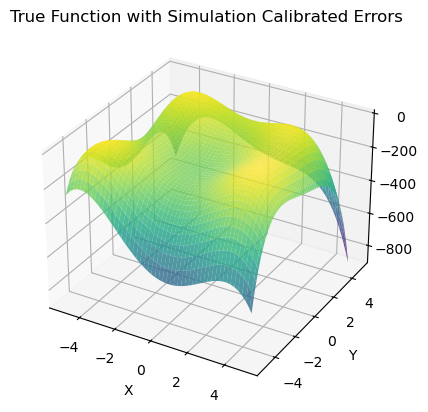

Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 4s 21ms/step - loss: 21026.9414
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 21942.2539 
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 20671.7246 
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 20851.7383 
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 20939.2598 
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 19988.1250 
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 18669.8691
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 17223.4727 
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 14623.2900 
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 11774.8652 
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 11045.1377
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 13120.4326 
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 11156.7139 
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 10395.3213 
Epoch 15/500
2/2 ━━━━━━━━━━━━━

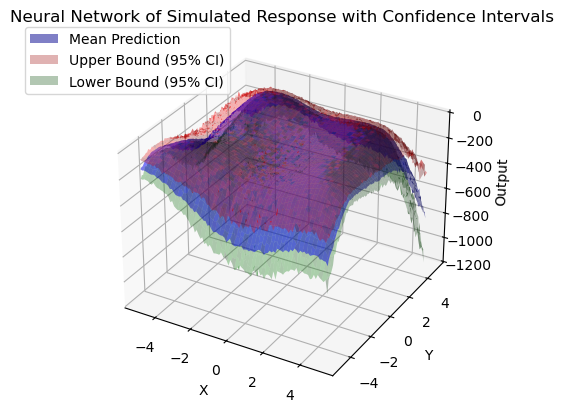

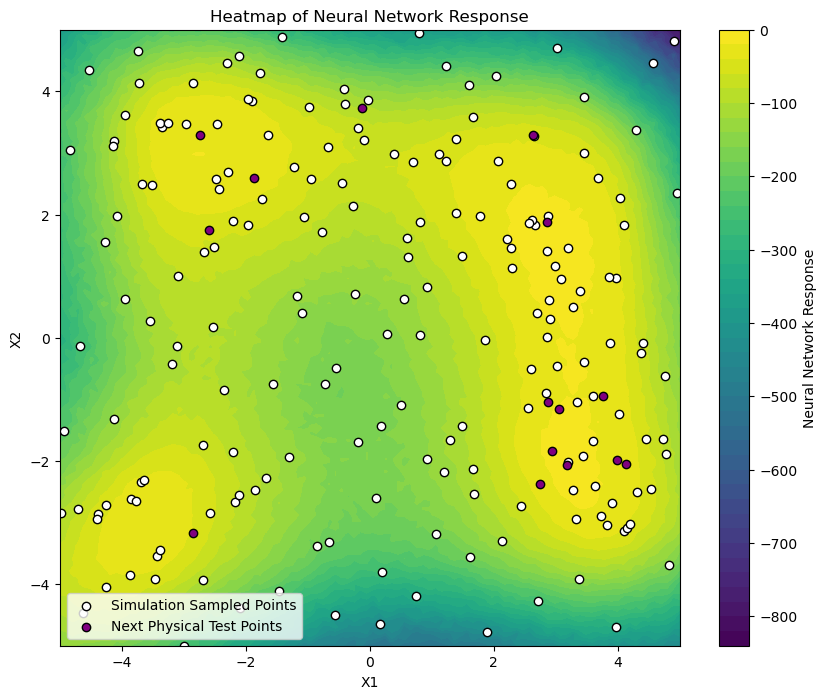

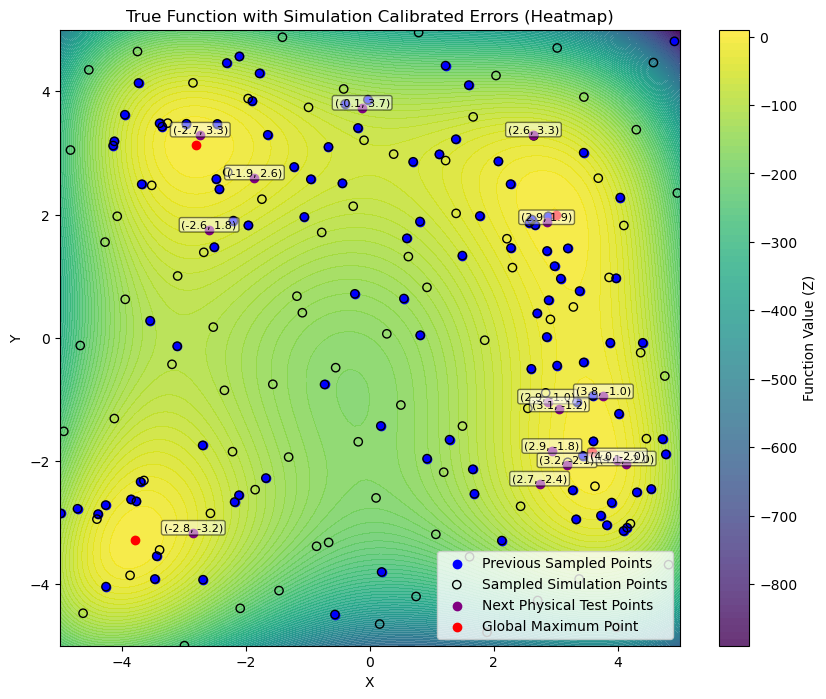

Selected 15 new test points. Median diff: 0.1267
[Iteration 6] RMSE: 0.2485, R²: 1.0000

=== Running with 20 physical experiments ===
[ 3.94766866 -2.71018102]


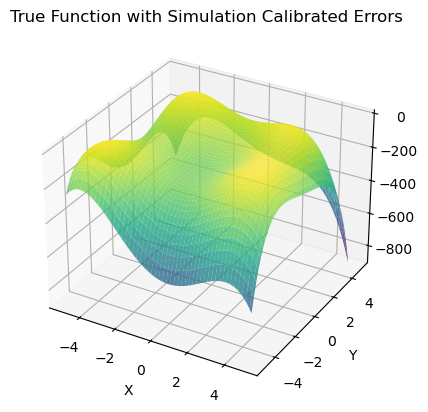

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 31349.6270
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - loss: 31317.7559
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 31276.5332
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 31219.5645
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 31117.3613
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 31018.3418
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 30858.8574
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - loss: 30623.1582
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 30323.2402
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 29948.5840
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 29385.7402
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 28620.5605
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 27539.0195
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 26250.4961
Epoch 15/500
1/1 ━━━━━━━━━━━━━━

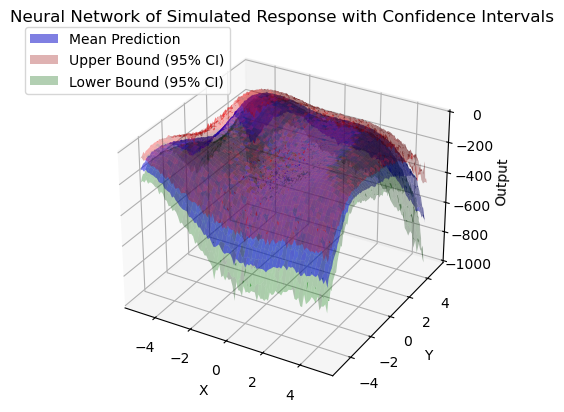

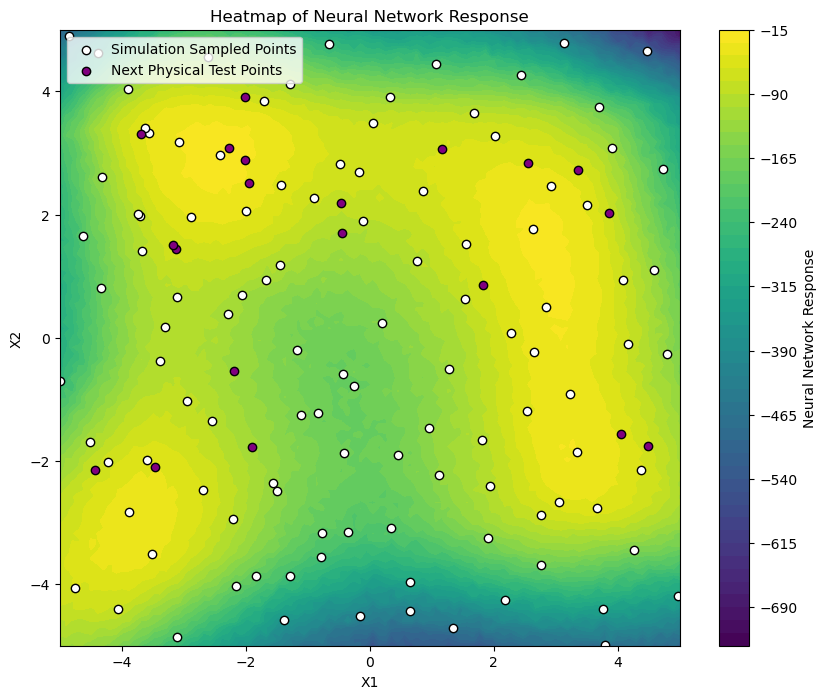

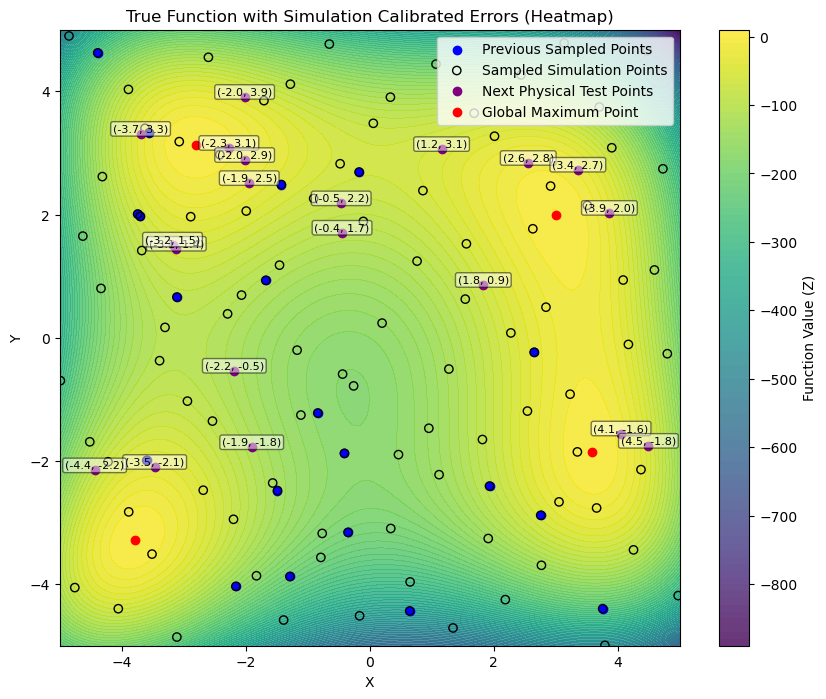

Selected 20 new test points. Median diff: 0.0076
[Iteration 0] RMSE: 1.2487, R²: 0.9998
[ 3.99192424 -2.72311682]


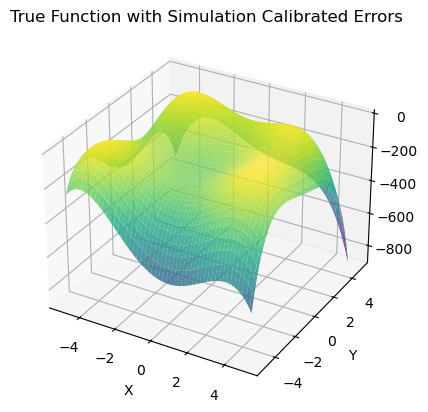

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 26305.1855
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 26279.5234
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 26235.1172
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 26185.4766
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 26119.6680
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 26018.0293
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 25888.9180
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 25661.0547
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - loss: 25487.4766
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 25084.2734
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - loss: 24597.4531
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 23932.8652
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 23155.0879
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 21955.6445
Epoch 15/500
1/1 ━━━━━━━━━━━━━━

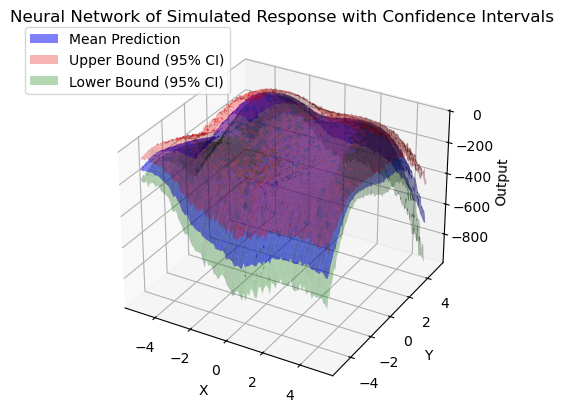

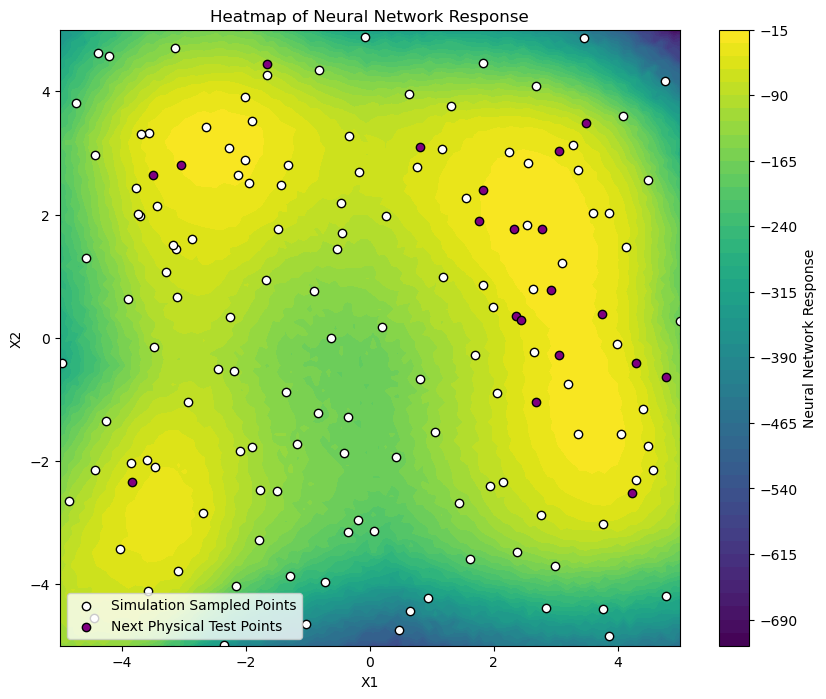

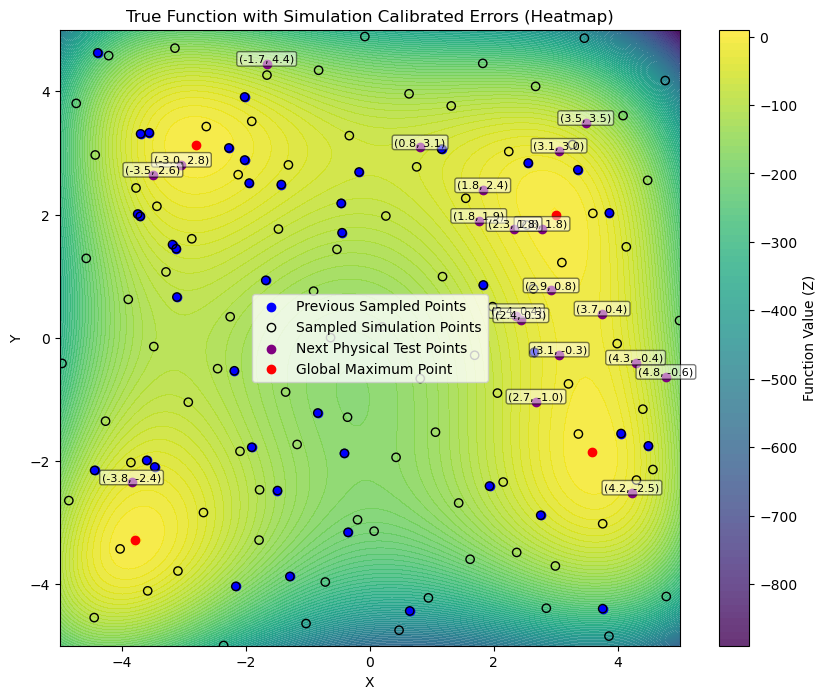

Selected 20 new test points. Median diff: -0.0586
[Iteration 1] RMSE: 0.2383, R²: 1.0000
[ 3.90638917 -2.87962425]


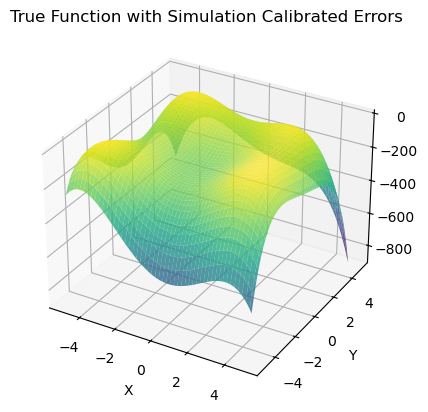

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step - loss: 23253.6426
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 23226.2422
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 23182.7500
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 23144.8301
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 23069.8730
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 22973.5840
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 22800.4453
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 22655.9609
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 22421.3281
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 22030.2617
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - loss: 21515.5000
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 20849.2109
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 20007.9766
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 19081.7695
Epoch 15/500
1/1 ━━━━━━━━━━━━━━

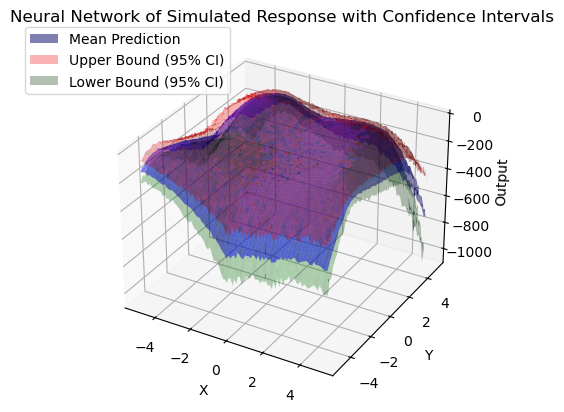

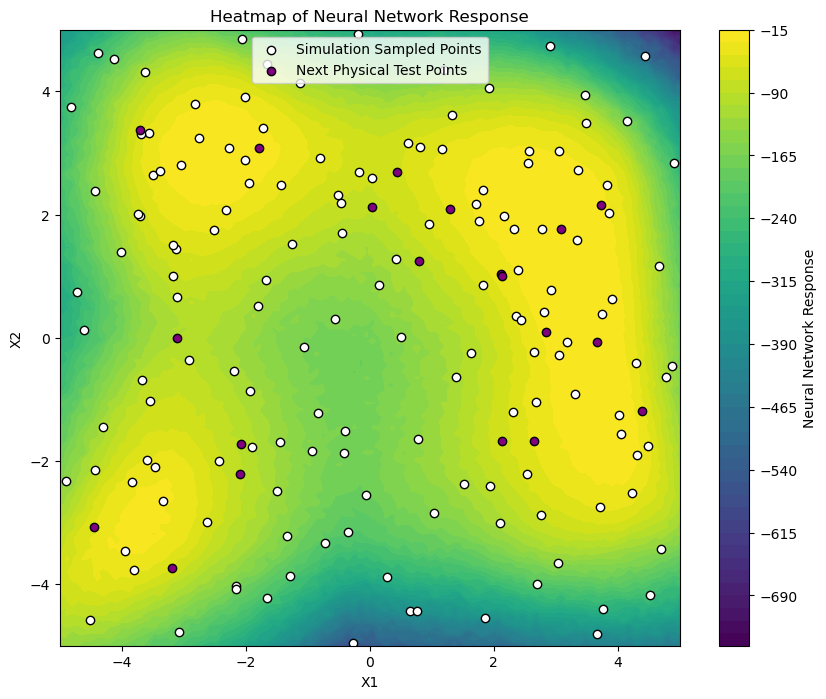

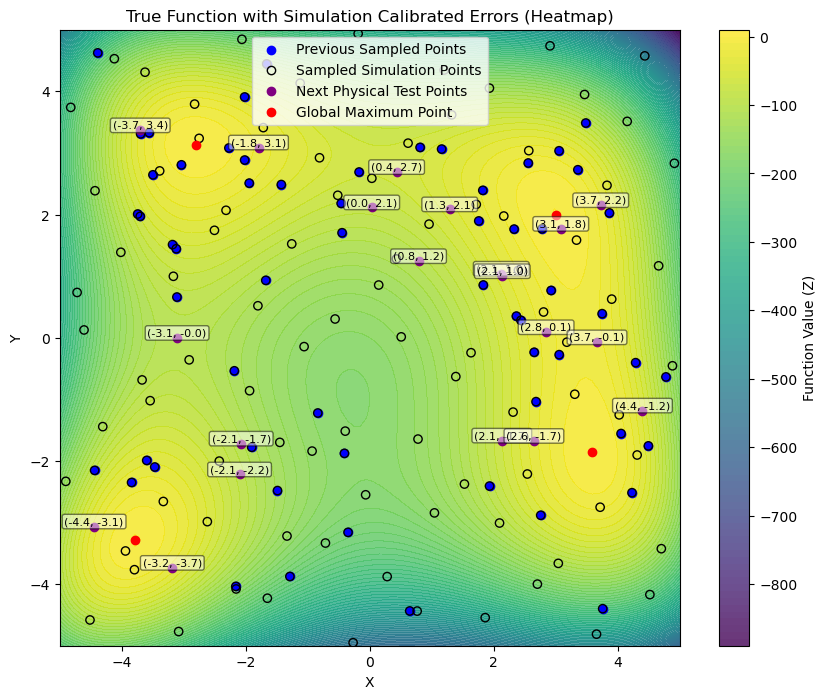

Selected 20 new test points. Median diff: -0.0058
[Iteration 2] RMSE: 0.2406, R²: 1.0000
[ 3.92442099 -2.94580592]


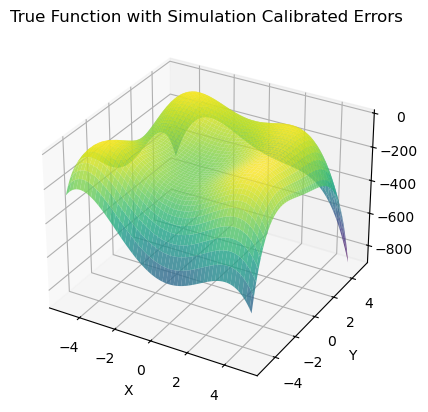

Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 20ms/step - loss: 20820.5332
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 20850.5176 
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 20161.8555 
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 20832.3008 
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 20987.4180 
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 20467.0996 
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 18976.0430 
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 18412.9648 
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 15745.4141 
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 13184.6221 
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 11022.0400 
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 9509.1016 
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 10582.5371 
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 8503.3398 
Epoch 15/500
2/2 ━━━━━━━━━━━━━━

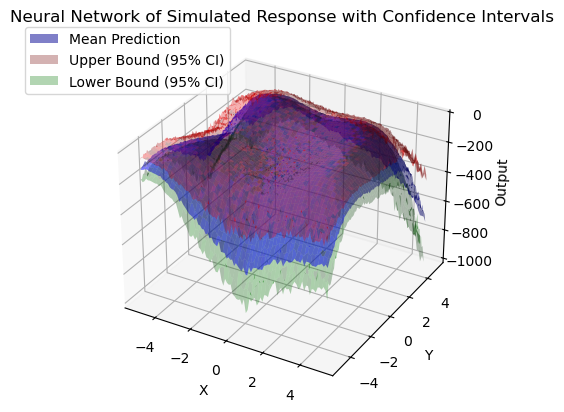

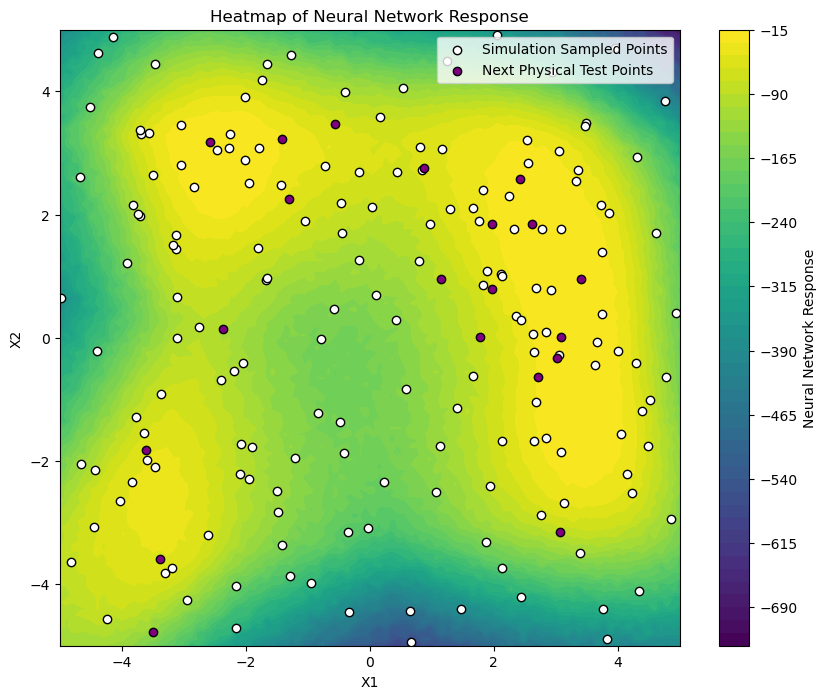

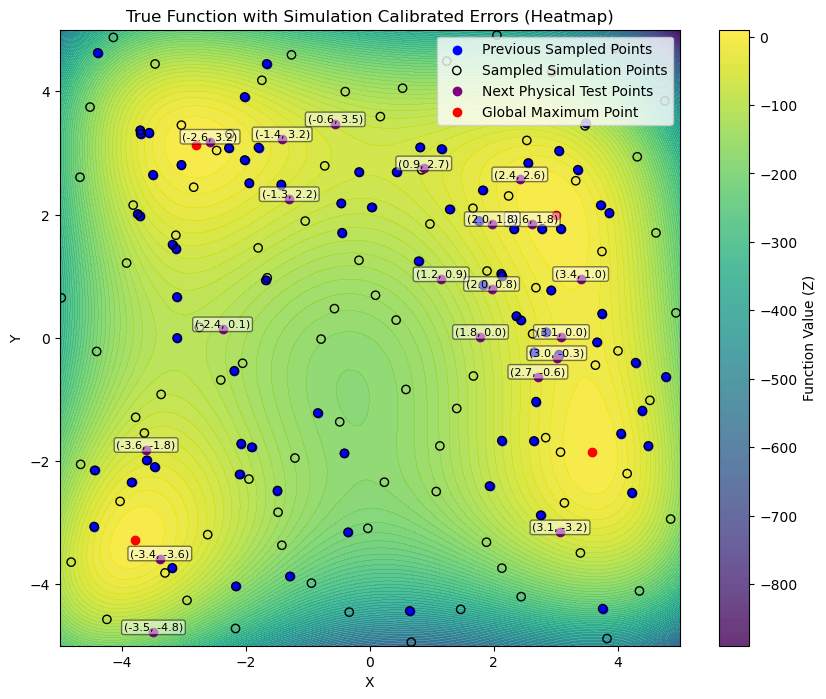

Selected 20 new test points. Median diff: -0.0332
[Iteration 3] RMSE: 0.2344, R²: 1.0000
[ 4.0252931  -2.90060136]


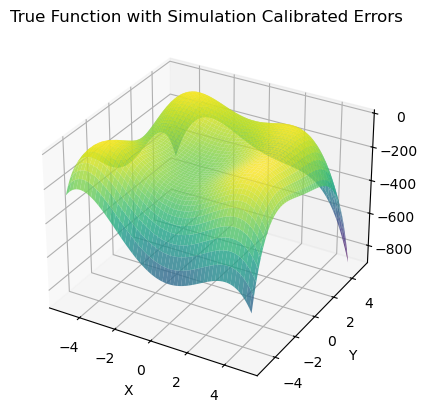

Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 24ms/step - loss: 18793.4316
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 18383.0859 
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 18030.1309 
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 18334.1270 
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 17528.9395 
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 17456.7461 
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 16168.0859 
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 14384.0967 
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 11528.4287 
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 9025.7012 
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 9068.9082 
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 9446.5273 
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8118.5298 
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 7563.8574 
Epoch 15/500
2/2 ━━━━━━━━━━━━━━━━━

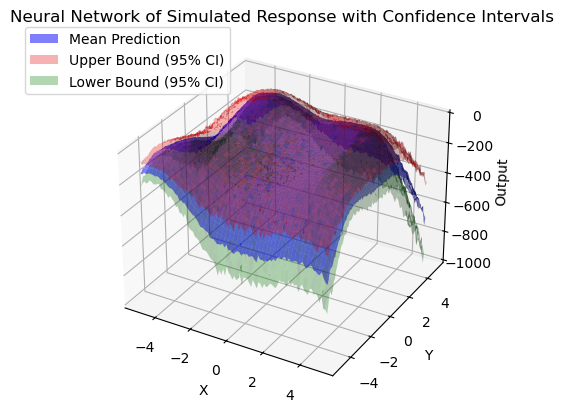

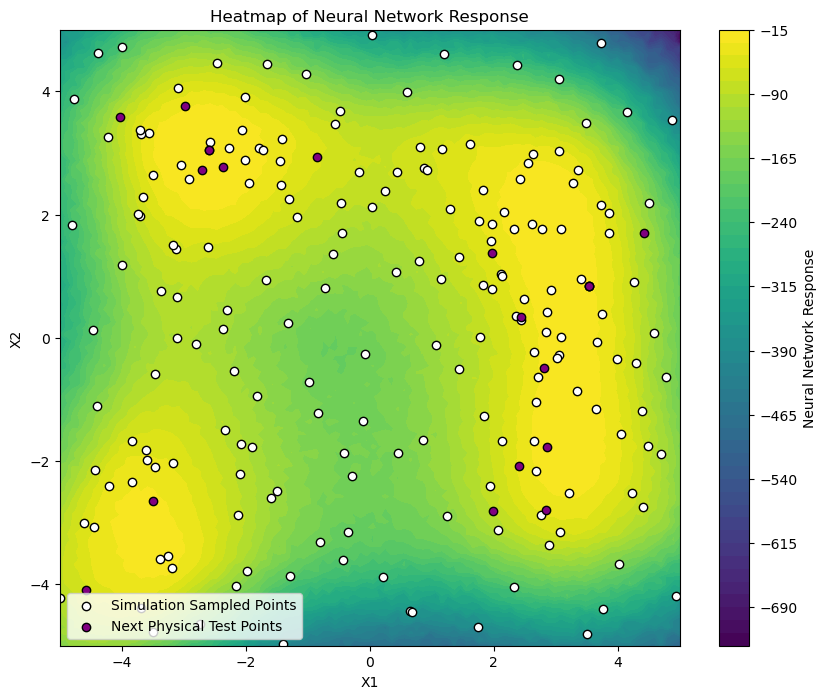

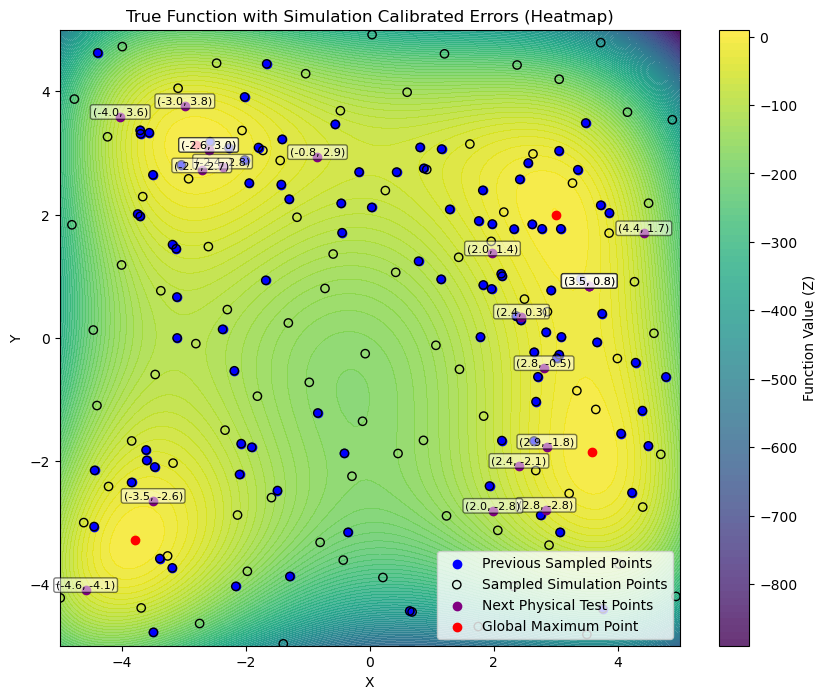

Selected 20 new test points. Median diff: 0.0998
[Iteration 4] RMSE: 0.2390, R²: 1.0000
[ 3.91317462 -2.92977617]


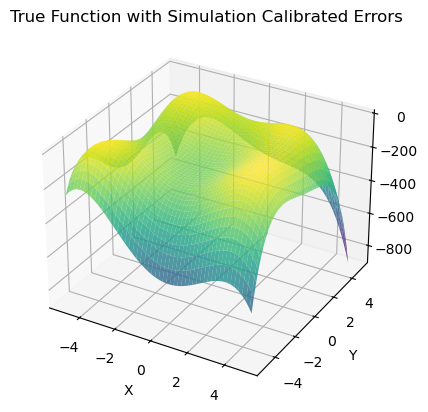

Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 16597.1074
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 17389.4434 
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 17117.9043 
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 17088.8496 
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 17421.9180 
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 15865.8340 
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 16146.9883 
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 14248.4854 
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 12741.1797 
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 9824.3584 
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 8426.4658 
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 8271.2031 
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 9115.4736 
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 7683.8667 
Epoch 15/500
2/2 ━━━━━━━━━━━━━━━━━━

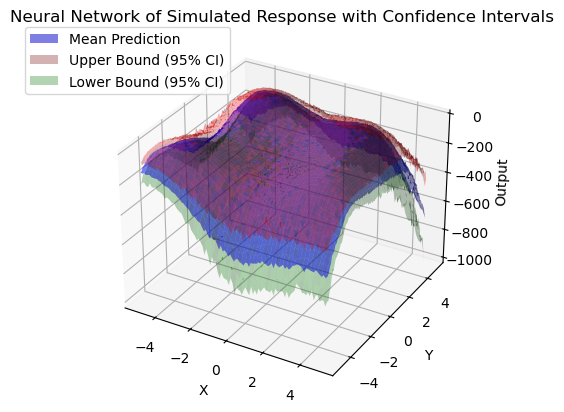

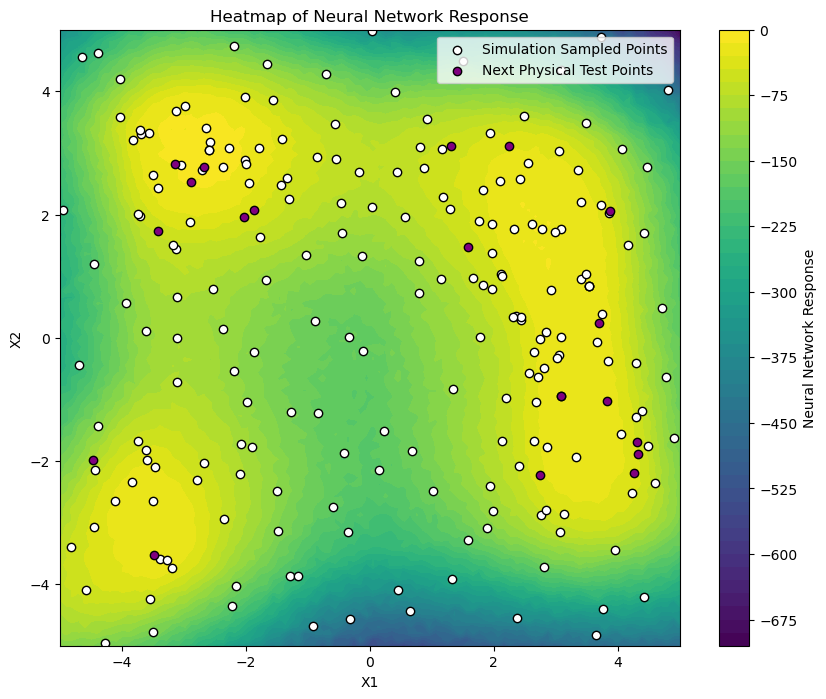

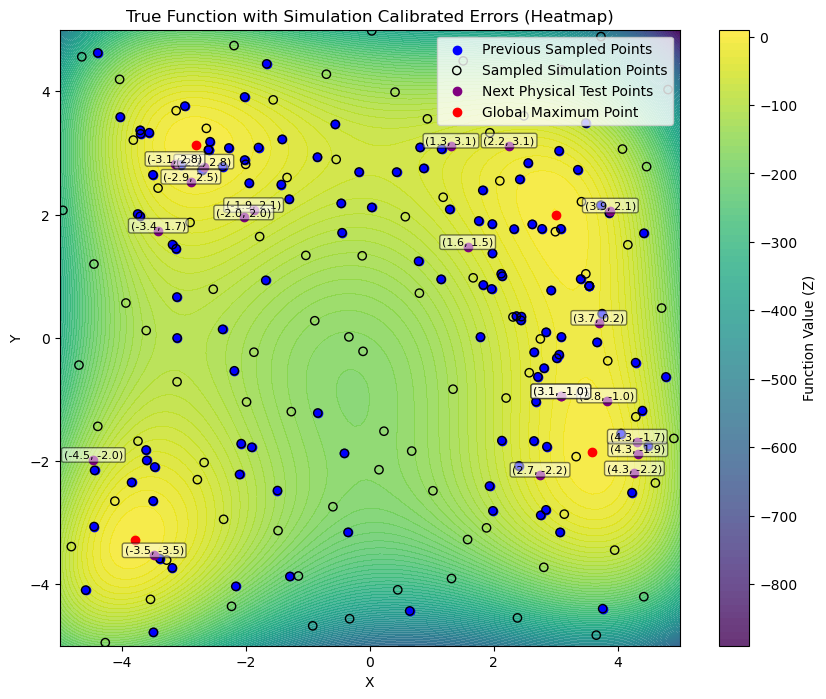

Selected 20 new test points. Median diff: 0.1060
[Iteration 5] RMSE: 0.3686, R²: 1.0000
[ 4.04109064 -2.92345616]


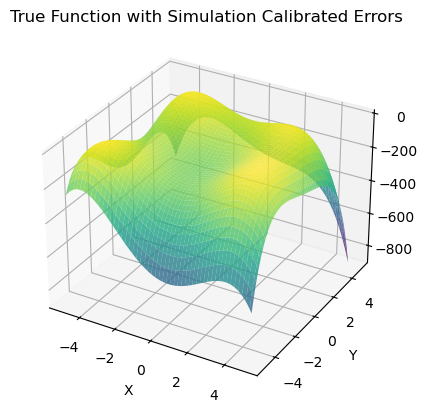

Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - loss: 15643.0137
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 16563.0430 
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 15742.0137 
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 16518.8320 
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 15476.3457 
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 14570.9131 
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 12950.9893
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 11825.7666 
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 8719.9414 
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 6974.6729 
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 7403.9268 
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 8131.6167 
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 6983.2632 
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 6800.9751 
Epoch 15/500
2/2 ━━━━━━━━━━━━━━━━━━

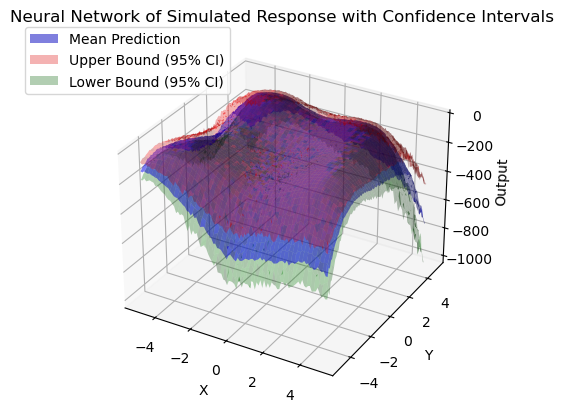

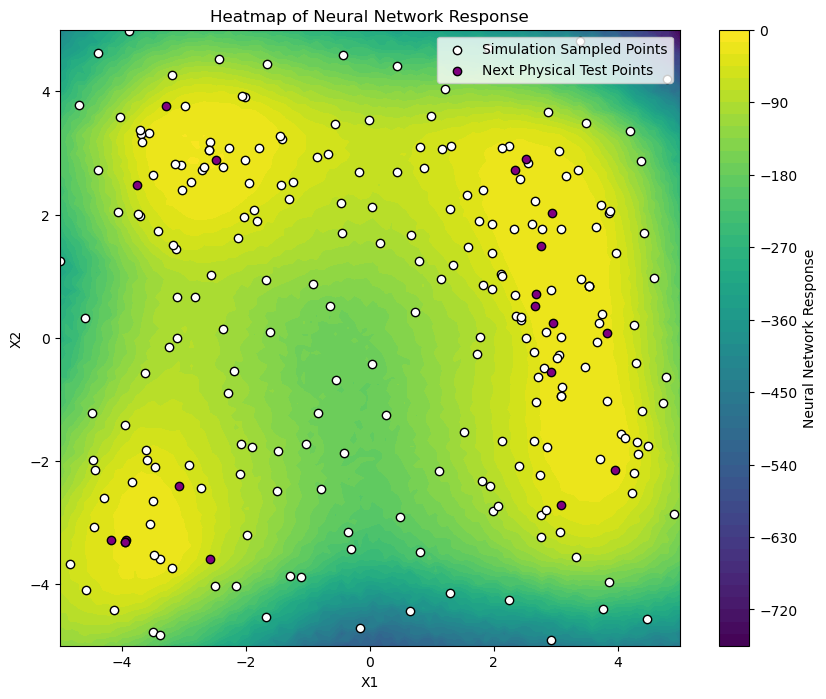

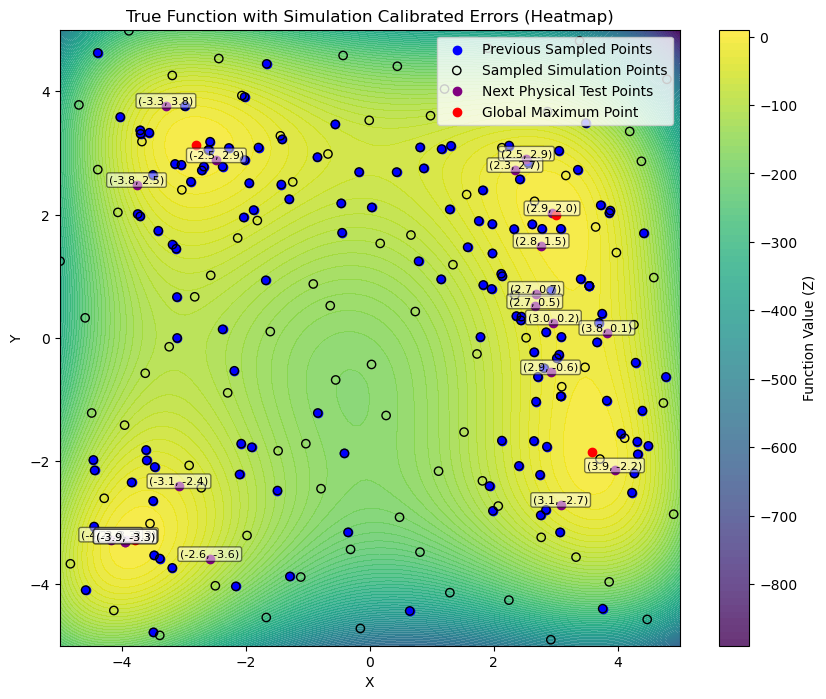

Selected 20 new test points. Median diff: -0.1164
[Iteration 6] RMSE: 0.6167, R²: 0.9999

=== Running with 25 physical experiments ===
[ 4.23247059 -2.90308678]


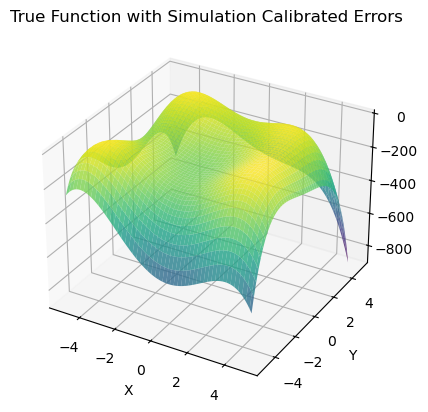

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 33060.7812
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 33025.7656
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 32995.0312
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - loss: 32946.4492
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step - loss: 32894.4570
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 32808.8516
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 32708.4746
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 32526.0957
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 32334.7656
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 32052.4453
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 31543.9121
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 30976.1094
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 30238.4414
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 29213.7930
Epoch 15/500
1/1 ━━━━━━━━━━━━━━

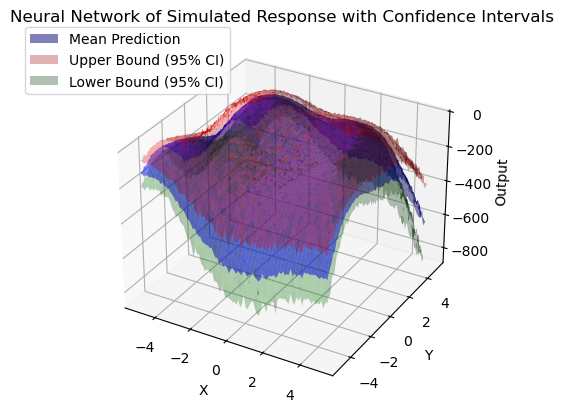

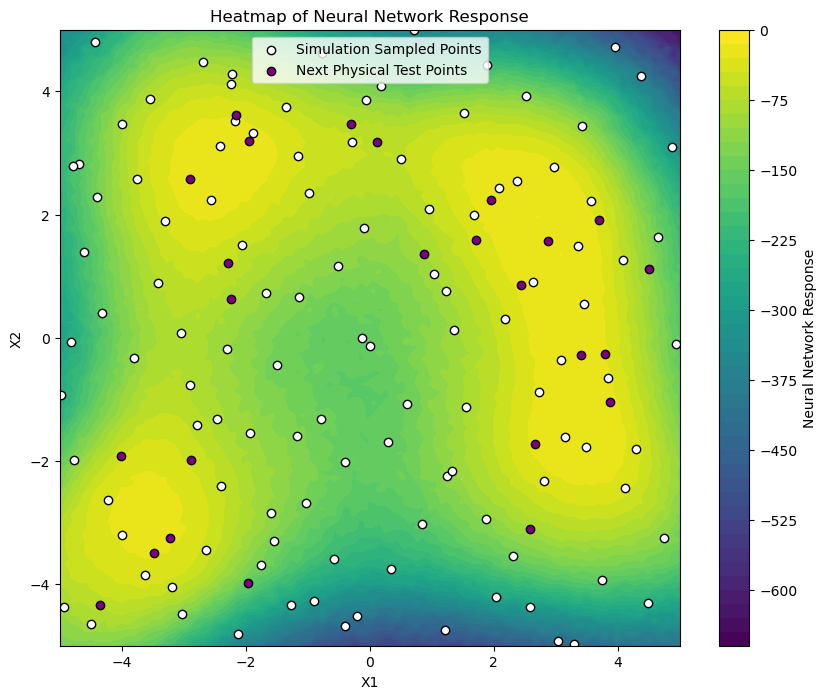

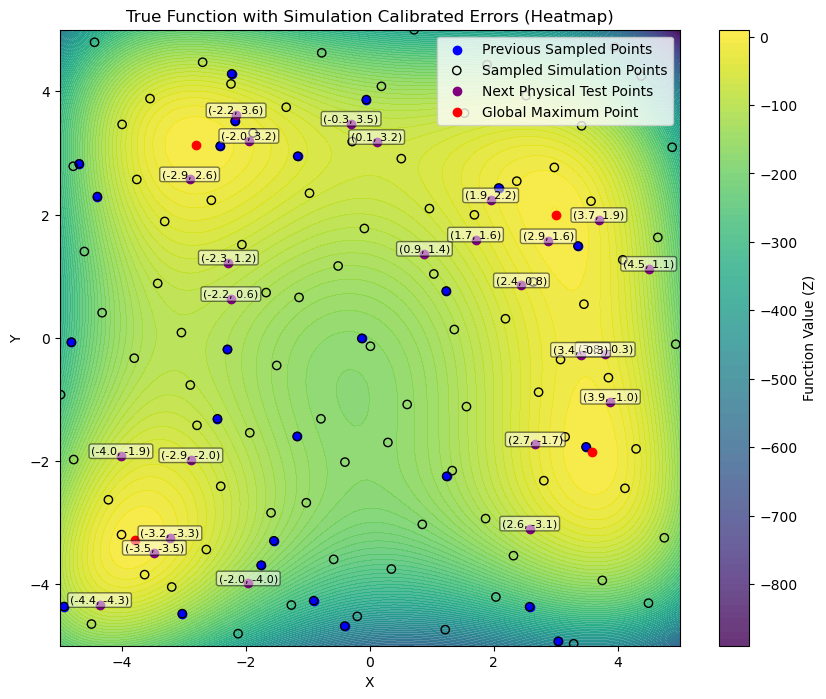

Selected 25 new test points. Median diff: -0.1095
[Iteration 0] RMSE: 2.0965, R²: 0.9996
[ 4.1839514  -3.00174233]


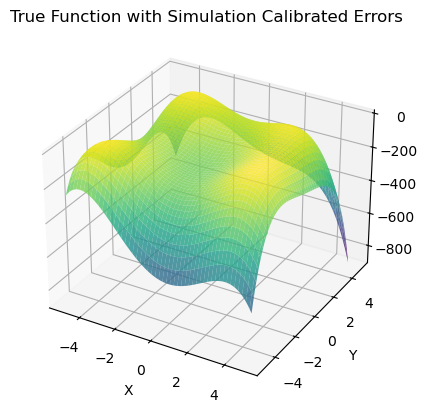

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 28321.5059
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 28287.1094
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 28256.0312
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 28222.2793
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - loss: 28180.4648
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 28117.4277
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 28044.3867
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 27922.2539
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 27820.6660
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 27597.3906
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 27311.2598
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 26957.8965
Epoch 13/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 26441.2676
Epoch 14/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 25744.5156
Epoch 15/500
1/1 ━━━━━━━━━━━━━━

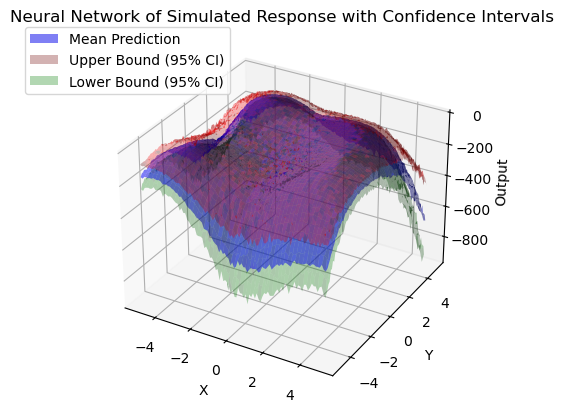

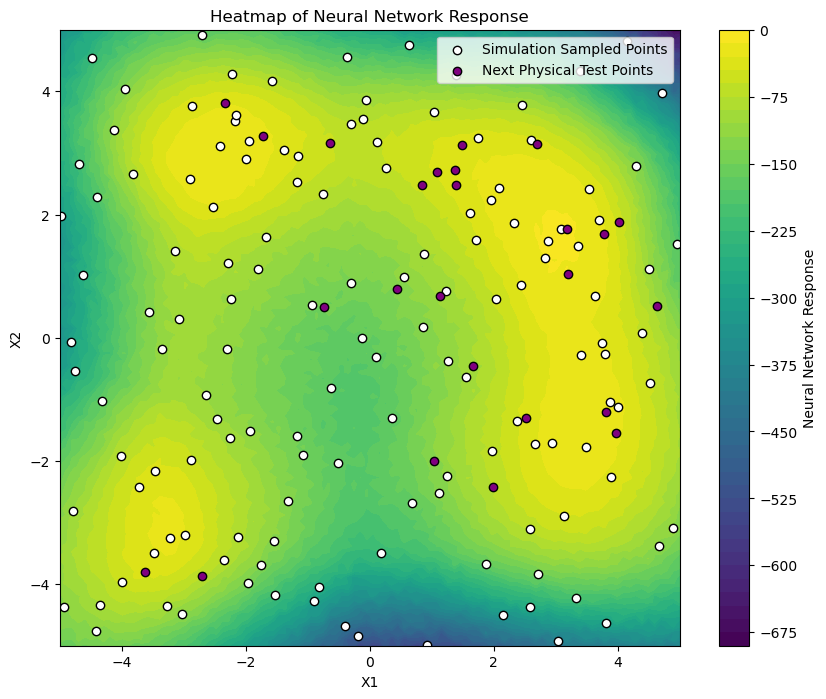

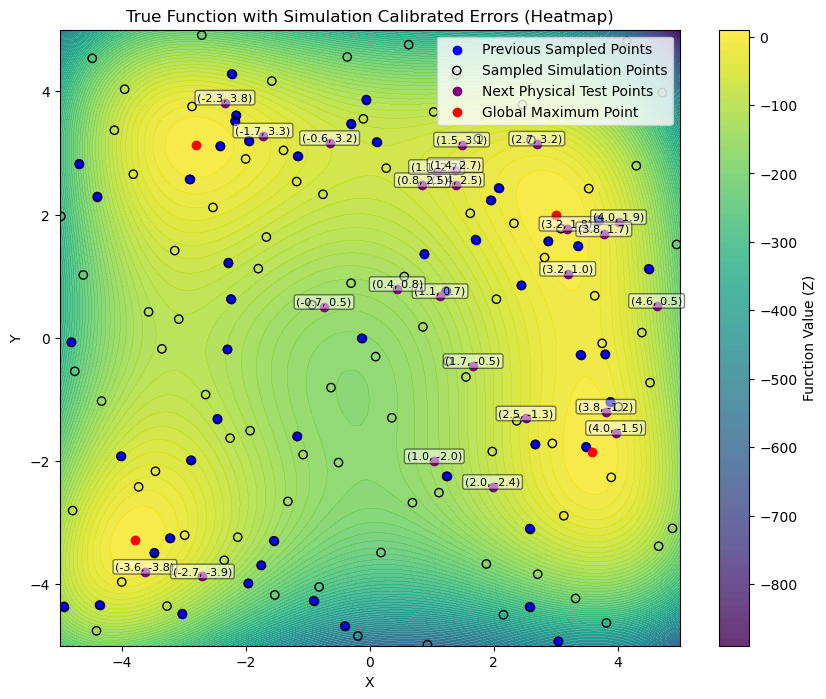

Selected 25 new test points. Median diff: -0.0563
[Iteration 1] RMSE: 0.2754, R²: 1.0000
[ 4.07339934 -3.01051189]


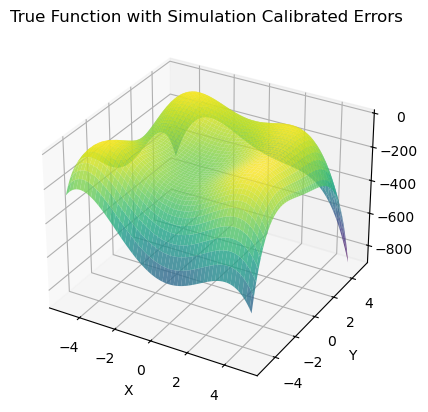

Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - loss: 23171.1230
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 23126.1211 
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 23522.3066 
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 22925.5488 
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 23298.5547
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 22472.6719 
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 22148.4395 
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 20059.0840 
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 18000.8438 
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 15842.0449 
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 12545.3193 
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9978.9004 
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 10233.7871
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9490.0693 
Epoch 15/500
2/2 ━━━━━━━━━━━━━━━━

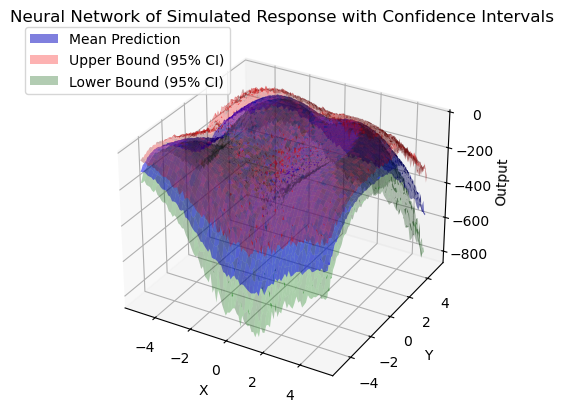

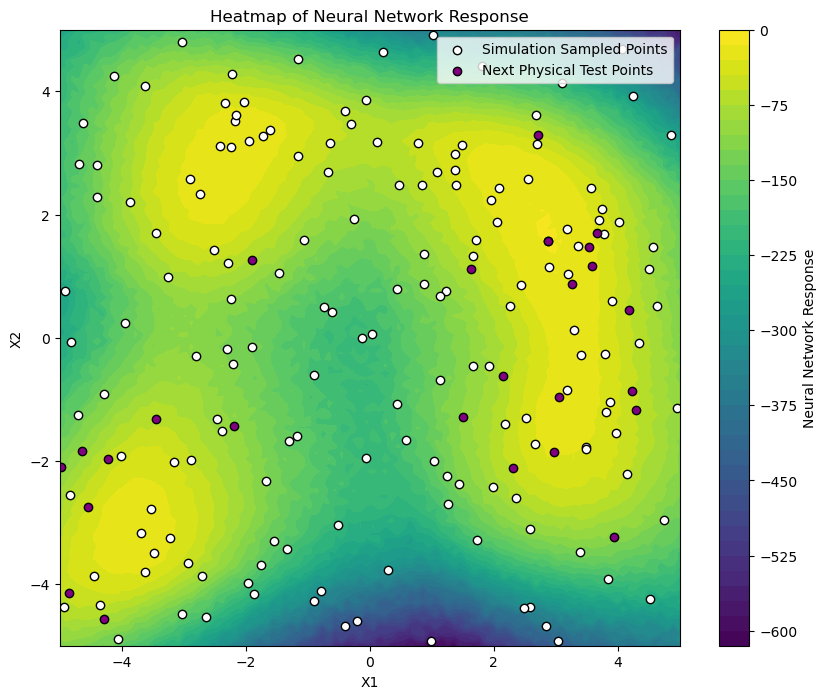

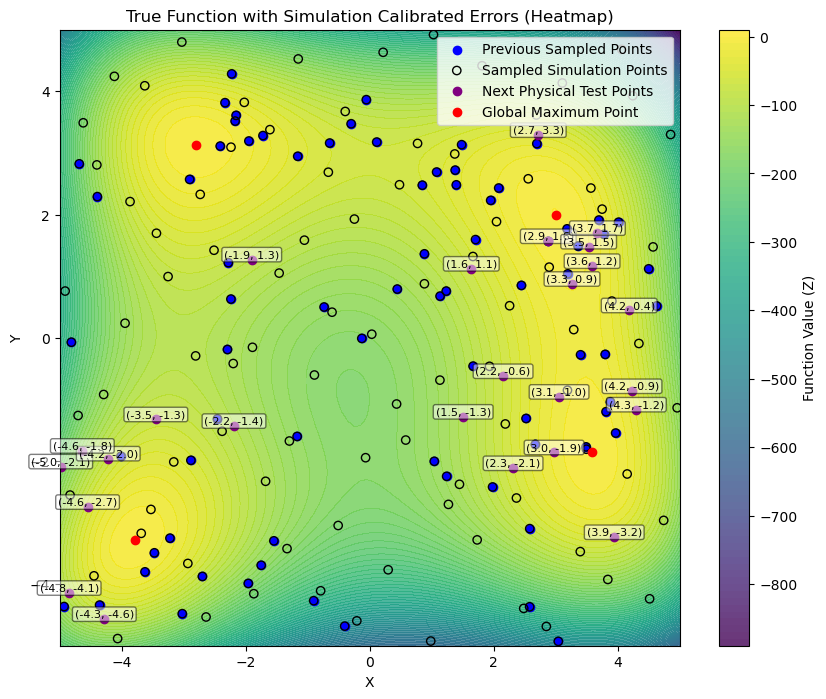

Selected 25 new test points. Median diff: -0.1087
[Iteration 2] RMSE: 5.4400, R²: 0.9957
[ 4.18083055 -3.11720461]


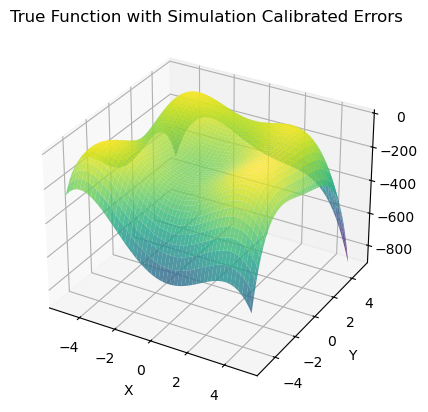

Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 21336.3516
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 21333.4805 
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 22172.5020 
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 21658.9961 
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 20782.4629 
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 19553.8633 
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 20787.3867 
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 19136.1406 
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 17431.8066 
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 13739.3154 
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 11087.4375 
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 9522.5684 
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 12595.9600 
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 10485.6699 
Epoch 15/500
2/2 ━━━━━━━━━━━━━━

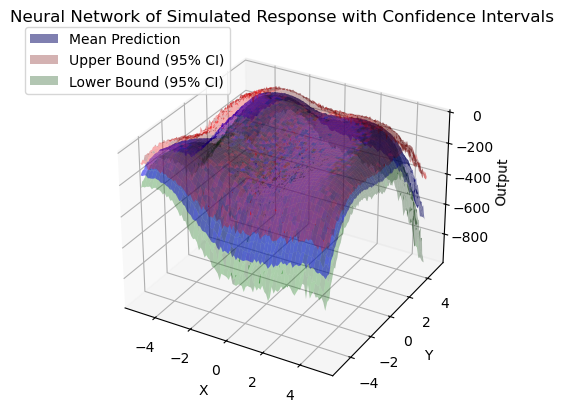

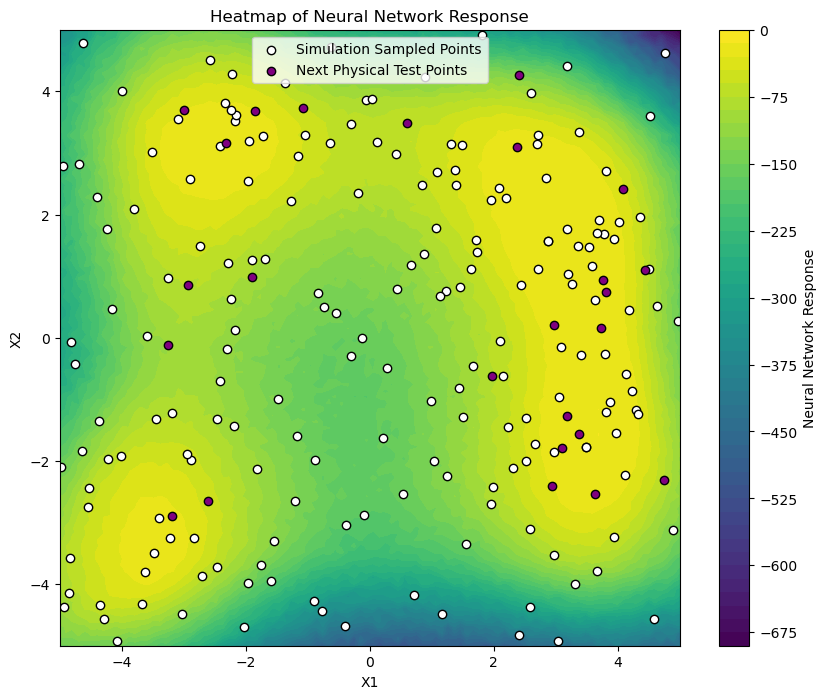

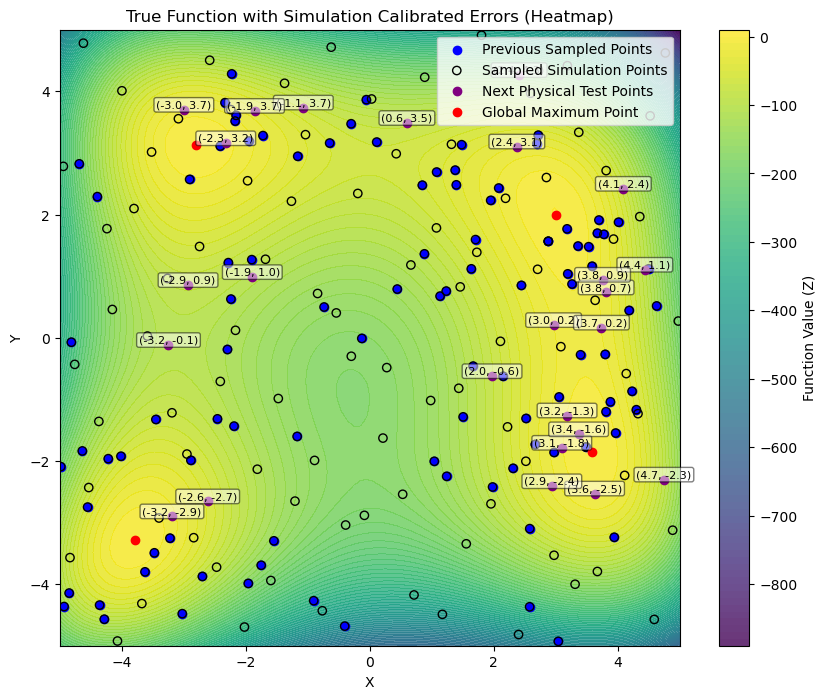

Selected 25 new test points. Median diff: 0.0207
[Iteration 3] RMSE: 2.2822, R²: 0.9991
[ 4.2271529 -3.060612 ]


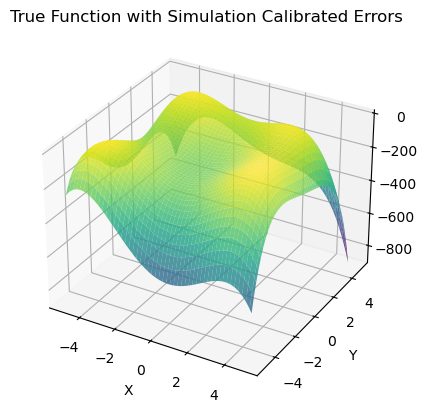

Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - loss: 20564.5234
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 19548.3477
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 19606.4199 
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 19247.1738 
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 19247.5898 
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 18799.0742
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 16733.3105 
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 15389.1045 
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 11654.2852 
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 9052.9746 
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 10556.9082 
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 10940.1846 
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 8567.2432 
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 8222.0234 
Epoch 15/500
2/2 ━━━━━━━━━━━━━━━━

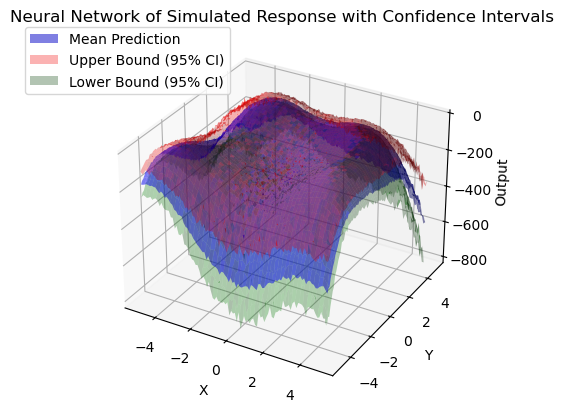

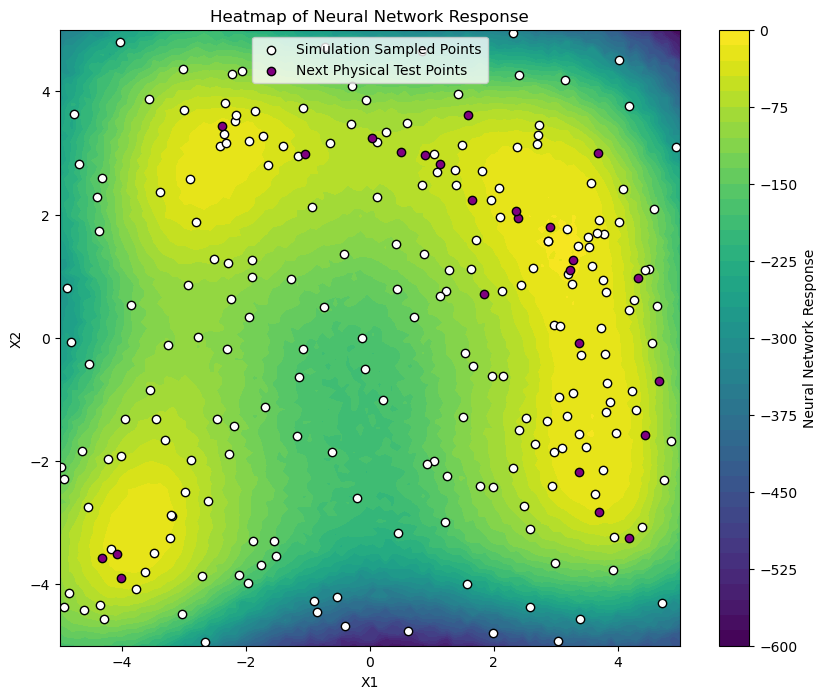

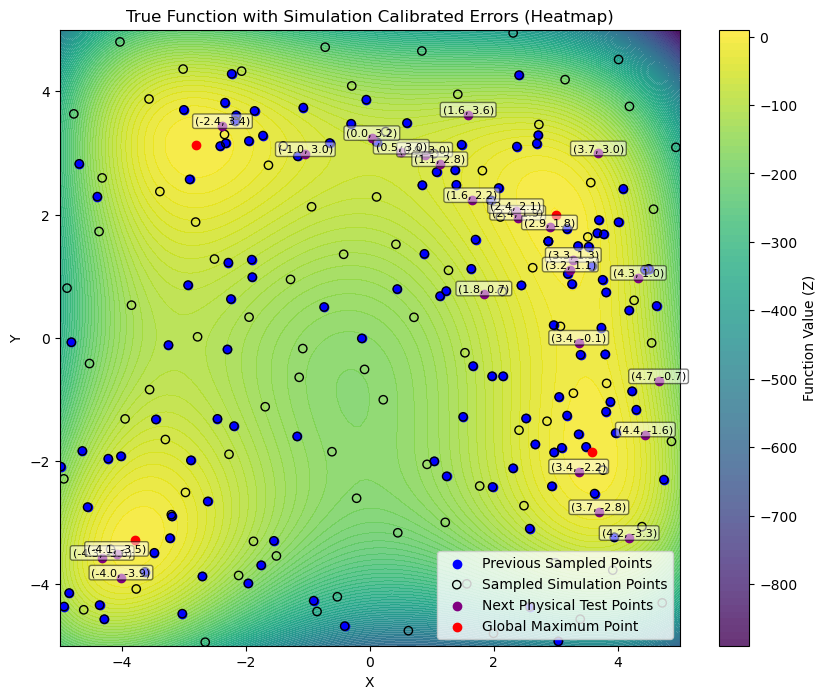

Selected 25 new test points. Median diff: -0.0498
[Iteration 4] RMSE: 1.3880, R²: 0.9996
[ 4.17264345 -3.04255589]


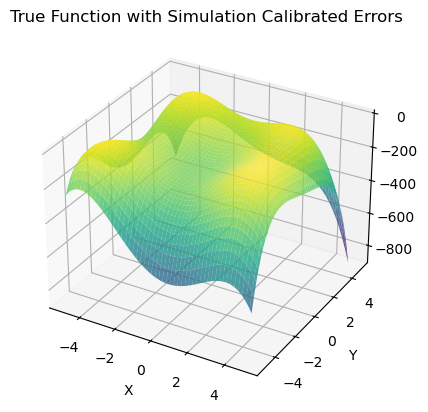

Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - loss: 17798.8066
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 17802.0176 
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 18431.5391 
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 17459.7012 
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 16156.0215 
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 16074.3154 
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 14669.2822 
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 12211.3057 
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 9493.5889 
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 8791.6084 
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 10492.8232 
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 9845.3223  
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 7710.0122 
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 7757.0288 
Epoch 15/500
2/2 ━━━━━━━━━━━━━━━━

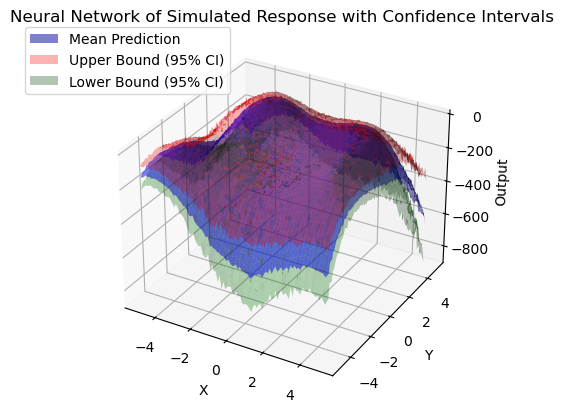

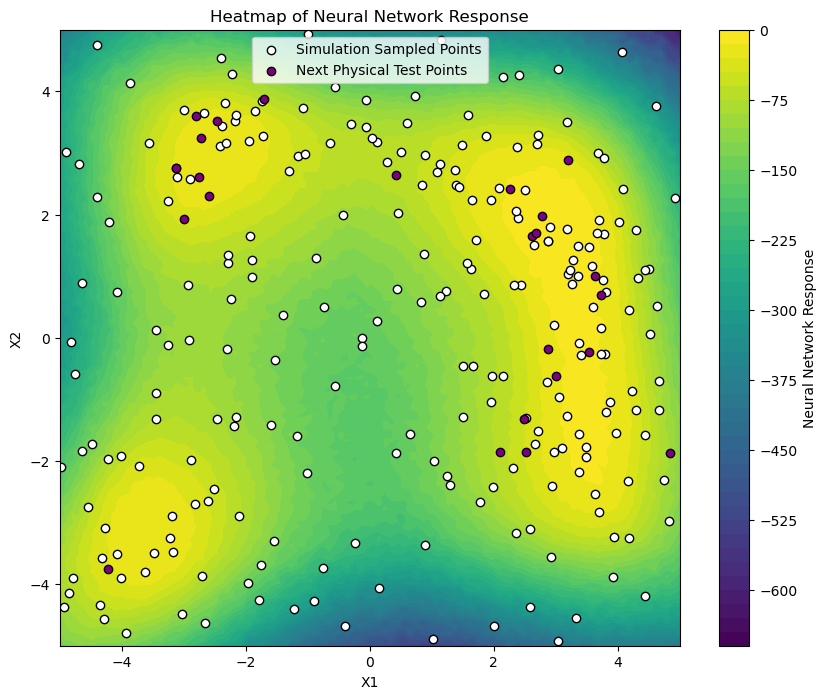

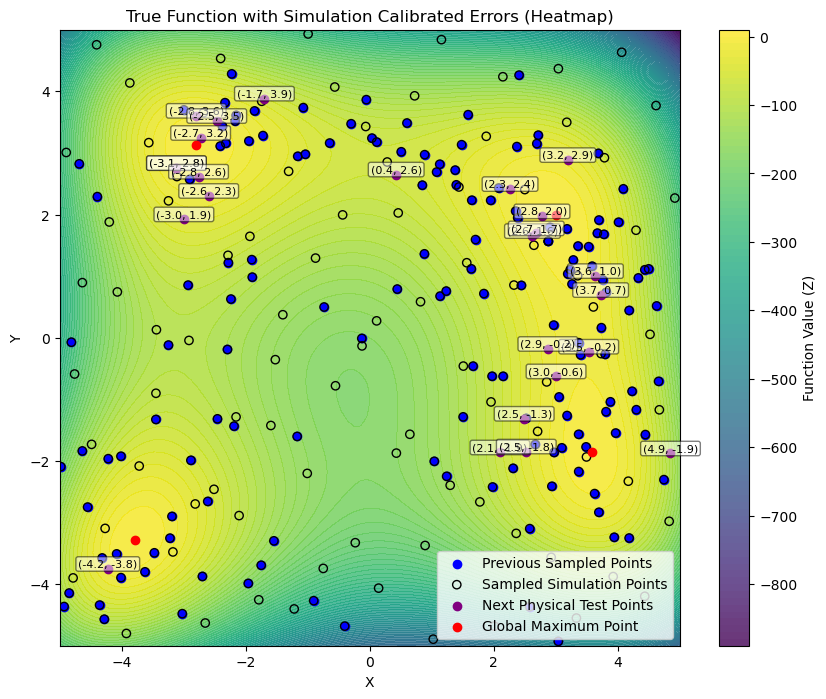

Selected 25 new test points. Median diff: 0.0453
[Iteration 5] RMSE: 0.2764, R²: 1.0000
[ 4.09677291 -3.07444264]


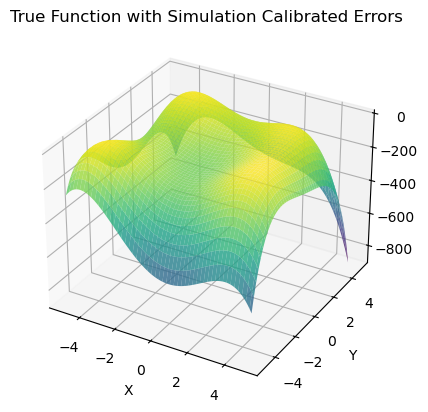

Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - loss: 16225.1396
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 16626.9785 
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 16571.8711 
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 16673.7070 
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 15838.3203 
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 15524.7090 
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 14414.4414 
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 13820.2451 
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 10457.0068
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 9163.3799 
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 8662.8652
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 9200.4746 
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 8787.5078 
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 7174.8823 
Epoch 15/500
2/2 ━━━━━━━━━━━━━━━━━━━

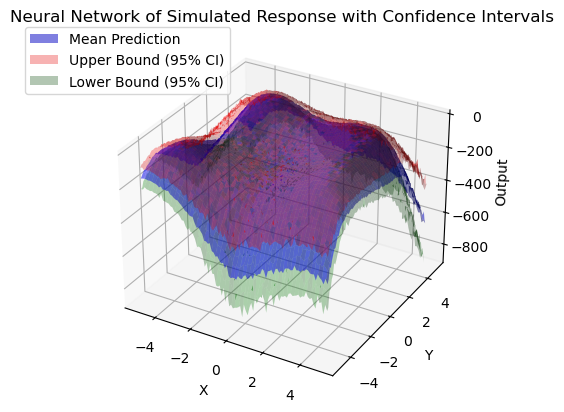

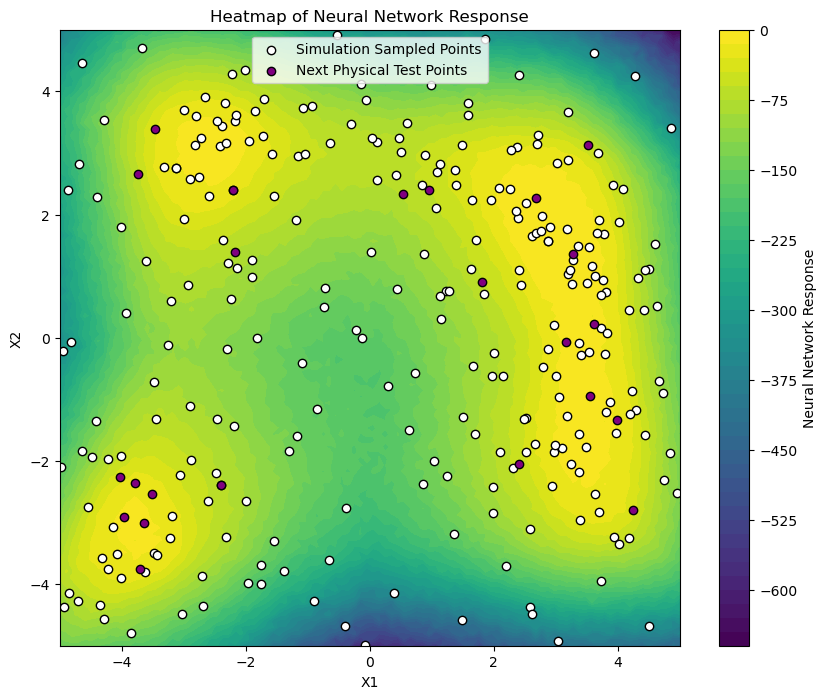

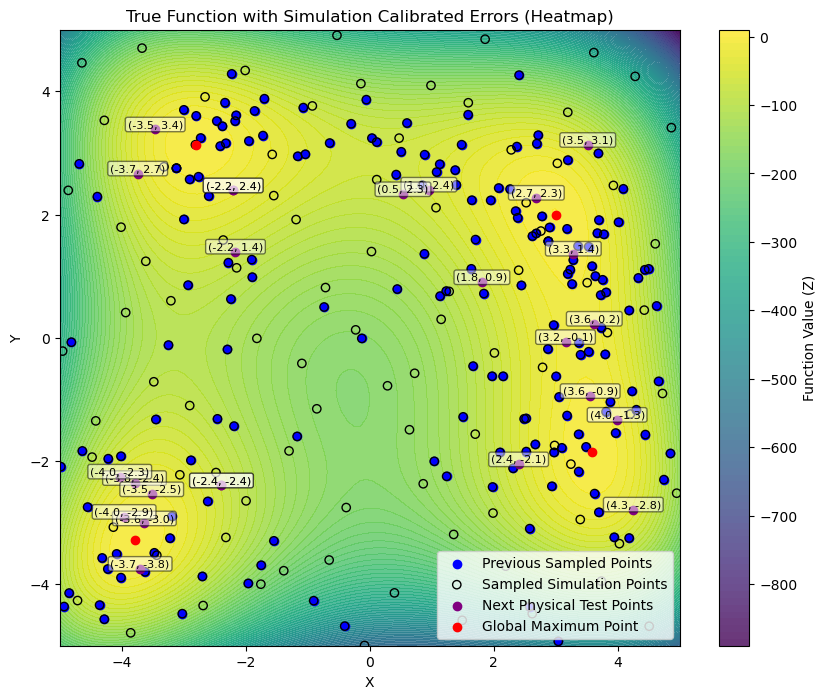

Selected 25 new test points. Median diff: -0.0593
[Iteration 6] RMSE: 0.2190, R²: 1.0000


In [57]:
from sklearn.metrics import mean_squared_error, r2_score

for exp_count in experiment_counts:
    print(f"\n=== Running with {exp_count} physical experiments ===")

    # Initialize your df with some starting data (maybe LHS or manual)
    df = initialize_df(n=exp_count)  # You define this function

    # For tracking RMSE, R2 over time
    rmse_list = []
    r2_list = []
    iteration_list = []

    for iteration in range(n_iterations_per_run):
        df = perform_iteration(
            df,
            iteration=iteration,
            rmse_list=rmse_list,
            r2_list=r2_list,
            iteration_list=iteration_list,
            exp_n=exp_count
        )

        # Compute final metrics for this iteration
        rmse = mean_squared_error(df["z"], df["sim_z"], squared=False)
        r2 = r2_score(df["z"], df["sim_z"])
        best_z = df["z"].max()

        log_metrics(exp_count, iteration, rmse, r2, best_z)

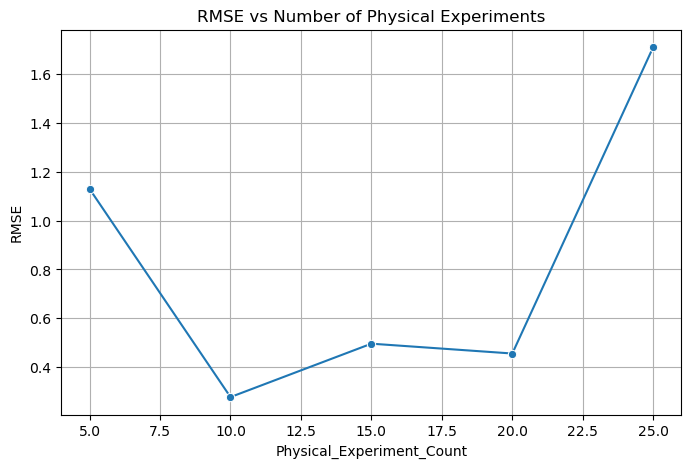

In [59]:
metrics_df = pd.DataFrame(results)

# Save to CSV
metrics_df.to_csv("experiment_metrics_summary1.csv", index=False)

# Plot example: RMSE vs Physical Experiment Count
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(8,5))
sns.lineplot(data=metrics_df, x="Physical_Experiment_Count", y="RMSE", ci=None, marker='o')
plt.title("RMSE vs Number of Physical Experiments")
plt.grid(True)
plt.show()

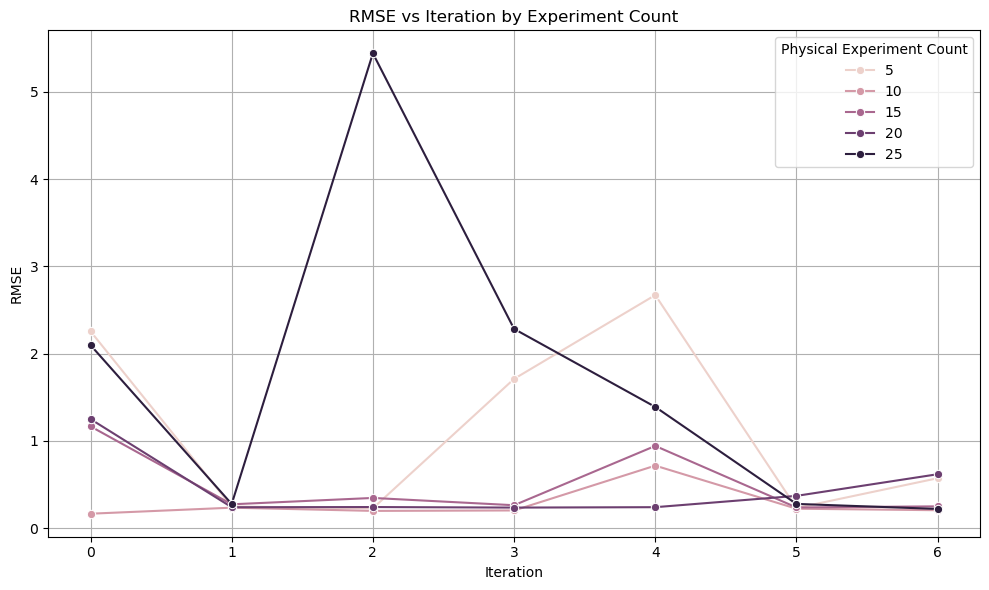

In [61]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))

sns.lineplot(
    data=metrics_df,
    x="Iteration",
    y="RMSE",
    hue="Physical_Experiment_Count",
    marker="o"
)

plt.title("RMSE vs Iteration by Experiment Count")
plt.xlabel("Iteration")
plt.ylabel("RMSE")
plt.legend(title="Physical Experiment Count")
plt.grid(True)
plt.tight_layout()
plt.show()

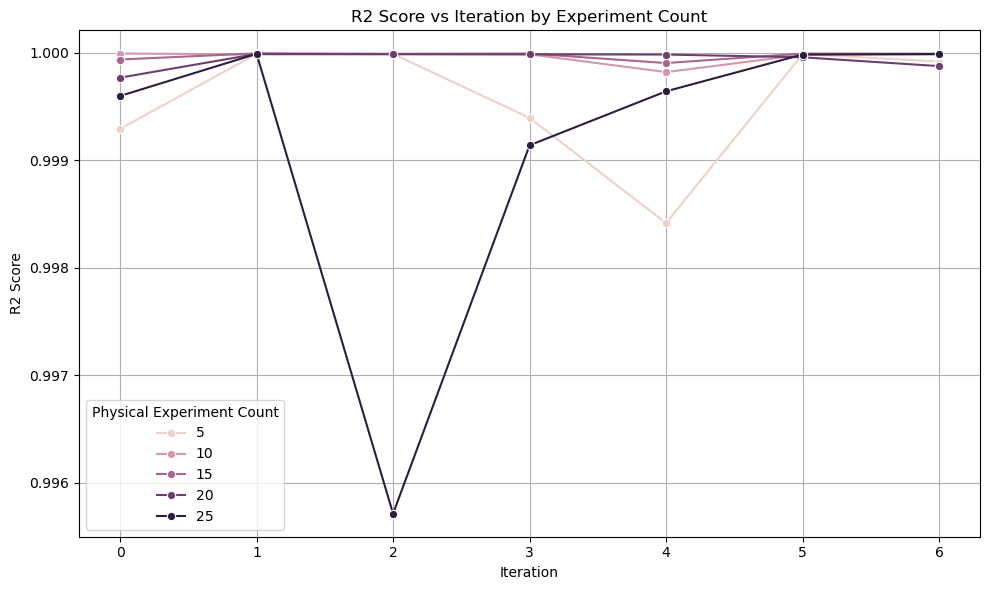

In [62]:
plt.figure(figsize=(10, 6))

sns.lineplot(
    data=metrics_df,
    x="Iteration",
    y="R2",
    hue="Physical_Experiment_Count",
    marker="o"
)

plt.title("R2 Score vs Iteration by Experiment Count")
plt.xlabel("Iteration")
plt.ylabel("R2 Score")
plt.legend(title="Physical Experiment Count")
plt.grid(True)
plt.tight_layout()
plt.show()

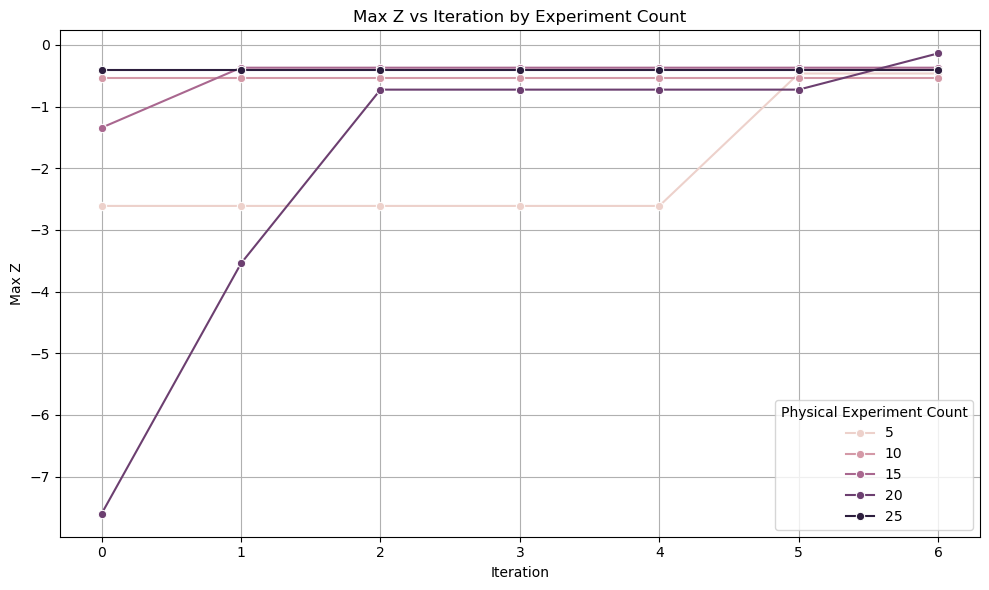

In [63]:
plt.figure(figsize=(10, 6))

sns.lineplot(
    data=metrics_df,
    x="Iteration",
    y="Best_Z",
    hue="Physical_Experiment_Count",
    marker="o"
)

plt.title("Max Z vs Iteration by Experiment Count")
plt.xlabel("Iteration")
plt.ylabel("Max Z")
plt.legend(title="Physical Experiment Count")
plt.grid(True)
plt.tight_layout()
plt.show()

In [60]:
metrics_df

,Physical_Experiment_Count,Iteration,RMSE,R2,Best_Z
0,5,0,2.254680,0.999293,-2.610617
1,5,1,0.246791,0.999990,-2.610617
2,5,2,0.226014,0.999990,-2.610617
3,5,3,1.709348,0.999395,-2.610617
4,5,4,2.669901,0.998415,-2.610617
5,5,5,0.229738,0.999988,-0.462705
6,5,6,0.570895,0.999919,-0.462705
7,10,0,0.164277,0.999994,-0.540012
8,10,1,0.233356,0.999986,-0.540012
9,10,2,0.196333,0.999989,-0.540012
